In [1]:
import set_env  # not included in the repo, defines $PROJECT_DIR, $PNC_PROJECT_DIR, $IMAGEN_PROJECT_DIR & $INPUT_DIR

In [2]:
import sys
import os
from glob import glob
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats
import statsmodels.formula.api as smf
import pickle
import statsmodels.stats.multitest
import sklearn
import pymare
from tqdm import tqdm

OUTPUT_DIR = {
    "pnc": os.path.join(os.environ["PNC_PROJECT_DIR"], "output"),
    "imagen": os.path.join(os.environ["IMAGEN_PROJECT_DIR"], "output"),
    "micamics": os.path.join(os.environ["PROJECT_DIR"], "output", "micamics")
}
INPUT_DIR = os.environ["INPUT_DIR"]
CODE_DIR = os.path.join(os.getcwd(), "..", "scripts")
sys.path.append(CODE_DIR)
from utils import transform, plot, stats, datasets
from modeling.check_fit import load_cmaes, load_cmaes_hist

import warnings
warnings.filterwarnings('ignore')

plt.rcParams.update({'font.size': 16, "font.family": "Asana Math", "figure.dpi": 300})
thcolor = '#44546A'
add_text = True # add statistics as text to some figures

/data/project/ei_development/env/lib/python3.10/site-packages/nilearn/input_data/__init__.py:23: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)


# Load data, calculate age effects and ICCs

Load data of the main run:

In [3]:
elig_subs = pd.read_csv(
    os.path.join(INPUT_DIR, "pnc_subs.csv"), index_col=0
).sort_index()
parcels = transform.load_ordered_parcel_labels('schaefer-100')

if os.path.exists('pnc_optima.csv') & os.path.exists('pnc_vars.pkz'):
    subjects_optima = pd.read_csv('pnc_optima.csv', index_col=0)
    with open('pnc_vars.pkz', 'rb') as f:
        regional_vars = pickle.load(f)
else:
    raise FileNotFoundError("Run Figure 2 first")
# select first rather than best runs for comparability with the other
# robustness analyses which also were done on one run
first_runs = subjects_optima.loc[subjects_optima['SeedMW']==1].index
data = subjects_optima.loc[first_runs].set_index("sub")
data[["age", "sex"]] = elig_subs.loc[data.index, ["age", "sex"]]
data["Age (y)"] = data["age"] / 12

# add motion data
motion = pd.read_csv(
    os.path.join(OUTPUT_DIR["pnc"], 'postfmriprep', 'participants.tsv'), 
    delimiter="\t", index_col=0
).loc[data.index]
data = pd.concat([data, motion], axis=1)

# load I_E
I_E = pd.DataFrame(index=data.index, columns=parcels, dtype=float)
for i, parc in enumerate(parcels):
    for sub, row in data.iterrows():
        I_E.loc[sub, parc] = regional_vars[sub][row['SeedMW']].loc[i, 'I_E']

Randomly select a subset of 200 subjects for the robustness analyses:

In [4]:
data["age_bin"] = pd.cut(data["Age (y)"], 10)
subsample = sklearn.utils.resample(
    data,
    replace=False,
    n_samples=200,
    random_state=0,
    stratify=data[["sex", "age_bin"]],
).index
# filter data to the subsample
data = data.loc[subsample]
I_E = I_E.loc[subsample]
# write it to a text file to use for running other robustness analysis simulations
np.savetxt(os.path.join(INPUT_DIR, 'pnc_subsample_200.txt'), subsample.to_numpy(), fmt="%s")

Split data into two age groups for comparing ICCs between them:

In [5]:
data_by_age = {
    'younger': data.loc[data['age']<data['age'].median()],
    'older': data.loc[data['age']>=data['age'].median()]
}

Load alternative simulations data that is used in this figure and its supplements:

In [6]:
all_data = {}
all_I_E = {}
all_data['main'] = data
all_I_E['main'] = I_E

# shared variables used in all runs
itMax = 81
lmbda = 210
n_vols_remove = 10
params = {
    'G': '0.5-4',
    'wee': '0.05-0.75',
    'wei': '0.05-0.75',
    'wie': '0',
}
het_params = 'wee-wei'

for alt in ['sc_temp', 'sch200', '2maps', 'nmda_gabaa', '4maps', 'inter', '6maps_rot', 'homo', 'node']:
    print(alt)
    # set parcellation
    if alt == 'sch200':
        parcellation_name = 'schaefer-200'
        nodes = 200
    else:
        parcellation_name = 'schaefer-100'
        nodes = 100
    parcels = transform.load_ordered_parcel_labels(parcellation_name)
    if alt not in ['sch200', 'node']:
        # performed using bnm_cuda
        # determine path of pre-curated data
        optima_filename = f'pnc200_{alt}_optima.csv'
        vars_filename = f'pnc200_{alt}_vars.pkz'
        # load pre-curated optima and regional variables data
        if os.path.exists(optima_filename) & os.path.exists(vars_filename):
            curr_subjects_optima = pd.read_csv(optima_filename, index_col=0)
            with open(vars_filename, 'rb') as f:
                curr_regional_vars = pickle.load(f)
        # otherwise curate it
        else:
            # set variables that vary across alternatives
            if alt in ['2maps', 'nmda_gabaa', '4maps', '6maps_rot', 'homo']:
                maps_name = alt
            else:
                maps_name = '6maps'
            if alt == 'homo':
                het_params = 'none'
                cmaes_subdir = os.path.join('homo', 'cmaes_gpu')
            else:
                het_params = 'wee-wei'
                cmaes_subdir = os.path.join(
                    f'{maps_name}_{parcellation_name}_zscore', 
                    'cmaes_multimaps_gpu'
                )
            if alt == 'sc_temp':
                cmaes_analysis_dirname = f'ctx_parc-{parcellation_name}_mean001'
            else: 
                cmaes_analysis_dirname = f'ctx_parc-{parcellation_name}_mean001_thresh-1' 
            if alt == 'inter':
                fc_prefix = f'ctx_parc-{parcellation_name}_hemi-LR_highpass-013_lowpass-none'
                exc_interhemispheric = False
            else:
                fc_prefix = f'ctx_parc-{parcellation_name}_hemi-LR_highpass-013_lowpass-none_exc-inter'
                exc_interhemispheric = True            
            SIM_DIR = os.path.join(OUTPUT_DIR["pnc"], 'sim')
            # loop through subjects and load their optimal simulation data
            curr_subjects_optima = []
            curr_regional_vars = {} 
            for sub in tqdm(data.index):
                if alt == 'sc_temp':
                    cmaes_dir = os.path.join(SIM_DIR, 'group-micamics', cmaes_analysis_dirname, sub, cmaes_subdir)
                    sc_path = os.path.join(
                        OUTPUT_DIR["micamics"], 'SC', 'group-all',
                        f'ctx_parc-{parcellation_name}_approach-median_mean001_desc-strength.txt'
                    )
                else:
                    cmaes_dir = os.path.join(SIM_DIR, sub, cmaes_analysis_dirname, cmaes_subdir)
                    sc_path = os.path.join(
                        OUTPUT_DIR["pnc"], 'SC', sub,
                        f'ctx_parc-{parcellation_name}_mean001_thresh-1_desc-strength.txt'
                    )
                sims_dir = cmaes_dir.replace("cmaes_", "sims_")
                emp_fc_tril_path = os.path.join(OUTPUT_DIR["pnc"], 'FC', sub, f'{fc_prefix}_desc-FCtril.txt')
                emp_fcd_tril_path = emp_fc_tril_path.replace('FCtril', 'FCDtril')
                emp_fc_tril = np.loadtxt(emp_fc_tril_path)
                emp_fcd_tril = np.loadtxt(emp_fcd_tril_path)
                curr_regional_vars[sub] = {}
                for SeedMW in [1]:
                    cmaes_res = load_cmaes(cmaes_dir, sims_dir, params, het_params,
                                           emp_fc_tril, emp_fcd_tril,
                                           sc_path=sc_path,
                                           n_vols_remove=n_vols_remove,
                                           itMax=itMax, lmbda=lmbda, SeedMW=SeedMW, 
                                           dataset='pnc',
                                           exc_interhemispheric=exc_interhemispheric,
                                           fc_prefix=fc_prefix,
                                          )
                    if cmaes_res:
                        cmaes_res[0]['sub'] = sub
                        cmaes_res[0]['SeedMW'] = SeedMW
                        curr_subjects_optima.append(cmaes_res[0])
                        curr_regional_vars[sub][SeedMW] = cmaes_res[1]
            curr_subjects_optima = pd.DataFrame(curr_subjects_optima)
            curr_subjects_optima.to_csv(optima_filename)
            with open(vars_filename, 'wb') as f:
                pickle.dump(curr_regional_vars, f)
        # select the first run and create I_E dataframe
        if alt == 'main':
            # select the first run (rather than best run) 
            # data to be comparable to other alternatives
            first_runs = curr_subjects_optima.loc[curr_subjects_optima['SeedMW']==1].index
            curr_data = curr_subjects_optima.loc[first_runs].set_index("sub")
        else:
            curr_data = curr_subjects_optima.set_index('sub')
        curr_I_E = pd.DataFrame(index=curr_data.index, columns=parcels, dtype=float)
        for i, parc in enumerate(parcels):
            for sub, row in curr_data.iterrows():
                curr_I_E.loc[sub, parc] = curr_regional_vars[sub][row['SeedMW']].loc[i, 'I_E']
    else:
        # performed using cuBNM
        optima_filename = f'pnc200_{alt}_optima.csv'
        I_E_filename = f'pnc200_{alt}_I_E.csv'
        # performed using cubnm
        if os.path.exists(optima_filename) & os.path.exists(I_E_filename):
            curr_data = pd.read_csv(optima_filename, index_col=0)
            curr_I_E = pd.read_csv(I_E_filename, index_col=0)
        else:
            if alt == 'node':
                maps_name = 'node'
            else:
                maps_name = '6maps'
            curr_subjects_optima = {}
            curr_I_E = {}
            for sub in tqdm(data.index):
                try:
                    curr_subjects_optima[sub] = pd.read_csv(
                        os.path.join(
                            OUTPUT_DIR['pnc'], 'sim',
                            sub, f'ctx_parc-{parcellation_name}_mean001', 
                            maps_name, 'cmaes_run-0', 'opt.csv'
                        ), index_col=0, header=None).iloc[:, 0]
                except FileNotFoundError:
                    print(sub, "does not exist")
                    continue
                # calculate SC-FC coupling (excluding interhemispheric)
                sc_path = os.path.join(
                    OUTPUT_DIR["pnc"], 'SC', sub,
                    f'ctx_parc-{parcellation_name}_mean001_thresh-1_desc-strength.txt'
                )
                sc = np.loadtxt(sc_path)
                sc[:nodes//2, nodes//2:] = np.NaN
                sc[nodes//2:, :nodes//2] = np.NaN
                sc_tril = sc[np.tril_indices(nodes, -1)]
                sc_tril = sc_tril[~np.isnan(sc_tril)]
                emp_fc_tril_path = os.path.join(
                    OUTPUT_DIR["pnc"], 'FC', sub,
                    f'ctx_parc-{parcellation_name}_hemi-LR_highpass-013_lowpass-none_exc-inter_desc-FCtril.txt'
                )
                emp_fc_tril = np.loadtxt(emp_fc_tril_path)
                curr_subjects_optima[sub]['sc_fc'] = np.corrcoef(sc_tril, emp_fc_tril)[0, 1]
                # load simulation data (I_E)
                npz_path = glob(
                    os.path.join(
                        OUTPUT_DIR['pnc'], 'sim',
                        sub, f'ctx_parc-{parcellation_name}_mean001', 
                        maps_name, 'cmaes_run-0', 'opt_sim', f'it*.npz')
                )[0]
                sim_data = np.load(npz_path, allow_pickle=True)
                curr_I_E[sub] = sim_data['sim_states'].reshape(-1)[0]['I_E'].squeeze()
            # collect and save optima
            curr_subjects_optima = pd.DataFrame(curr_subjects_optima).T.drop(columns=[np.NaN])
            # remove + and - from GOF measures
            curr_subjects_optima.columns = [s.replace('-','').replace('+','') for s in curr_subjects_optima.columns]
            curr_subjects_optima['fcd_ks'] = -curr_subjects_optima['fcd_ks']
            curr_subjects_optima['fc_diff'] = -curr_subjects_optima['fc_diff']
            curr_I_E = pd.DataFrame(curr_I_E).T
            curr_I_E.columns = parcels
            curr_subjects_optima.to_csv(optima_filename)
            curr_I_E.to_csv(I_E_filename)
            curr_data = curr_subjects_optima
    # add demographics
    curr_data[['age', 'sex']] = elig_subs.loc[curr_data.index,['age', 'sex']]
    curr_data['Age (y)'] = curr_data['age'] / 12
    # add motion data
    motion = pd.read_csv(
        os.path.join(OUTPUT_DIR["pnc"], 'postfmriprep', 'participants.tsv'), 
        delimiter="\t", index_col=0
    ).loc[curr_data.index]
    curr_data = pd.concat([curr_data, motion], axis=1)
    all_data[alt] = curr_data
    all_I_E[alt] = curr_I_E

sc_temp
sch200
2maps
nmda_gabaa
4maps
inter
6maps_rot
homo
node


Calculate the age effects of E-I ratio as well as its ICC (compared to main run) in each configuration across the 200 subsample subjects:

In [7]:
all_stats = {}
all_ICCs = {}
all_ICCs_by_age = {}
alts = ['main', 'sc_temp', 'sch200', '2maps', 'nmda_gabaa', '4maps', 'inter', '6maps_rot', 'homo', 'node']
main_alts = ['main', 'sc_temp', 'sch200', '2maps', 'nmda_gabaa', '4maps', 'inter']

for alt in alts:
    print(alt)
    # set parcellation
    if alt == 'sch200':
        parcellation_name = 'schaefer-200'
        nodes = 200
    else:
        parcellation_name = 'schaefer-100'
        nodes = 100
    parcels = transform.load_ordered_parcel_labels(parcellation_name)
    # combine I_E and data
    df = pd.concat([all_I_E[alt], all_data[alt]], axis=1)
    df.columns = [f'IE_{i}' for i in range(nodes)] + list(df.columns[nodes:])
    # calculate parcel-wise age effects
    t = pd.Series(index=parcels)
    r = pd.Series(index=parcels)
    p = pd.Series(index=parcels)
    Ns = pd.Series(index=parcels)
    outliers = {}
    for i, parc in enumerate(parcels):
        # exclude outliers
        curr_subs = df.index[(scipy.stats.zscore(df.loc[:, f'IE_{i}']).abs() < 3)]
        outliers[parc] = set(df.index) - set(curr_subs)
        model_df = df.loc[curr_subs]
        # fit the confound removal model to calculate pearson's r of the
        # residual of I_E with age as an easy-to-interpret effect size
        res_conf = smf.ols(f"IE_{i} ~ gof + sex + mean_rms", data=model_df).fit()
        r.loc[parc] = scipy.stats.pearsonr(model_df["age"], res_conf.resid).statistic
        # fit the model
        mod = smf.ols(f'IE_{i} ~ age + gof + sex + mean_rms', data=model_df)
        res = mod.fit()
        t.loc[parc] = res.tvalues['age']
        p.loc[parc] = res.pvalues['age']
        Ns.loc[parc] = len(curr_subs)
    
    # FDR correction
    _, p_fdr = statsmodels.stats.multitest.fdrcorrection(p)
    p_fdr = pd.Series(p_fdr, index=parcels)
    
    # aggregate stats
    all_stats[alt] = pd.DataFrame({"t": t, "r": r, "p": p, "p_fdr": p_fdr, "N": Ns})
    all_stats[alt].to_csv(f"p_pnc200_{alt}_IE_age_stats.csv")

    # calculate ICC
    if alt in main_alts[1:]:
        # for schaefer-200 to make the parcels comparable
        # reparcellate main from schaefer-100 to schaefer-200
        if alt == 'sch200':
            I_E_main = transform.parcellate_surf(transform.deparcellate_surf(all_I_E['main'].T, 'schaefer-100'), 'schaefer-200', concat=True).T
            I_E_main.index=all_I_E['main'].index
        else:
            I_E_main = all_I_E['main']
        # ICC across all subjects
        all_ICCs[alt] = pd.Series(index=parcels, dtype=float)
        for i, parc in enumerate(parcels):
            icc_df = pd.DataFrame(index=all_data[alt].index, columns=['main', 'alt'], dtype=float)
            for sub in I_E.index:
                icc_df.loc[sub, 'main'] = I_E_main.loc[sub, parc]
                icc_df.loc[sub, 'alt'] = all_I_E[alt].loc[sub, parc]
            all_ICCs[alt].loc[parc] = stats.madicc(icc_df.loc[:, 'main'], icc_df.loc[:, 'alt'])
        # ICC in younger vs older age groups
        all_ICCs_by_age[alt] = pd.DataFrame(index=parcels, dtype=float)
        for age in data_by_age.keys():
            for i, parc in enumerate(parcels):
                icc_df = pd.DataFrame(index=data_by_age[age].index, columns=['main', 'alt'], dtype=float)
                for sub in data_by_age[age].index:
                    icc_df.loc[sub, 'main'] = I_E_main.loc[sub, parc]
                    icc_df.loc[sub, 'alt'] = all_I_E[alt].loc[sub, parc]
                all_ICCs_by_age[alt].loc[parc, age] = stats.madicc(icc_df.loc[:, 'main'], icc_df.loc[:, 'alt'])
        all_ICCs_by_age[alt]['all'] = all_ICCs[alt]

main
sc_temp
sch200
2maps
nmda_gabaa
4maps
inter
6maps_rot
homo
node


# Figure 5A. Main run with default configurations 

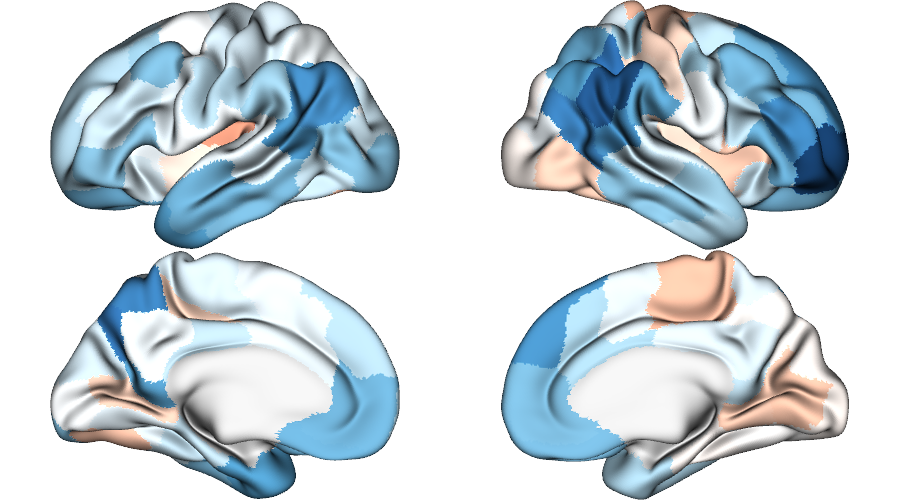

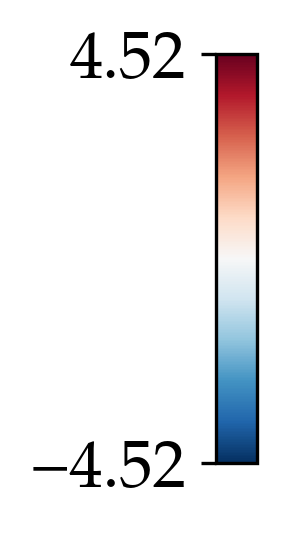

In [8]:
vmin = min(all_stats['main']['t'].values.min(), -all_stats['main']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['main']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

# Figure 5B and S8. Robustness of the findings to the effect of inter-individual variability of structural connectome

## 5B. Effect of age on E-I ratio using template SC (unthresholded)

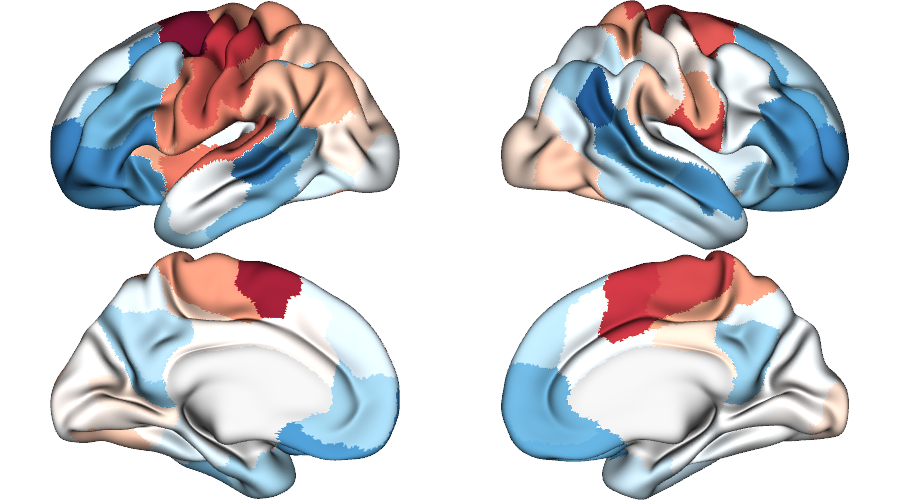

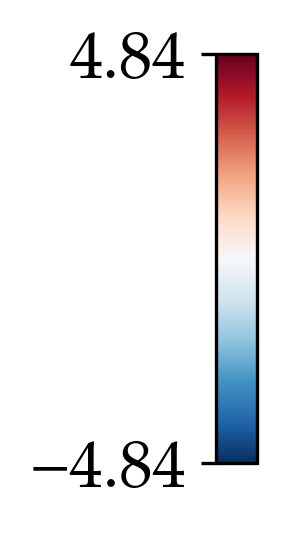

In [9]:
vmin = min(all_stats['sc_temp']['t'].values.min(), -all_stats['sc_temp']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['sc_temp']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

## S8B. Effect of age on E-I ratio using template SC

### (i) FDR-significant effects

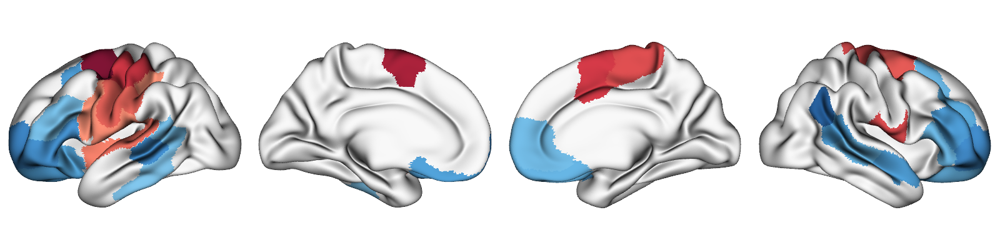

In [10]:
vmin = min(all_stats['sc_temp']['t'].values.min(), -all_stats['sc_temp']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['sc_temp']['t'][all_stats['sc_temp']['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (ii) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.4854542531701813 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.43955812825591556 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(Template SC)', ylabel='E-I ratio age effect\n(Subject SC)'>

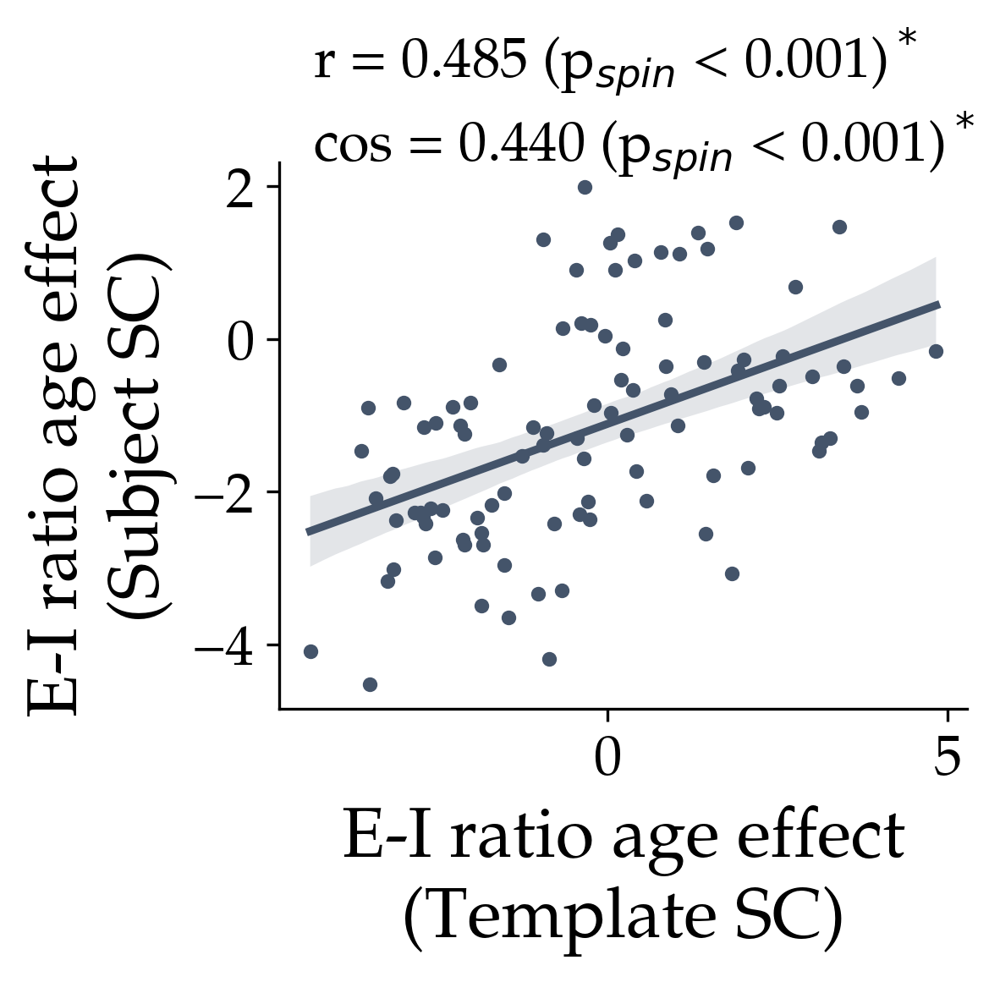

In [11]:
plot.reg_plot(
    all_stats['sc_temp'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(Template SC)',
    ylabel='E-I ratio age effect''\n(Subject SC)'
)

### (iii) ICC

       younger    older      all
count  100.000  100.000  100.000
mean     0.227    0.377    0.319
std      0.183    0.201    0.165
min     -0.353   -0.111   -0.179
25%      0.120    0.261    0.231
50%      0.250    0.411    0.335
75%      0.347    0.518    0.425
max      0.708    0.763    0.632
T =-7.4583472869524385, p = 3.4041118591577194e-11


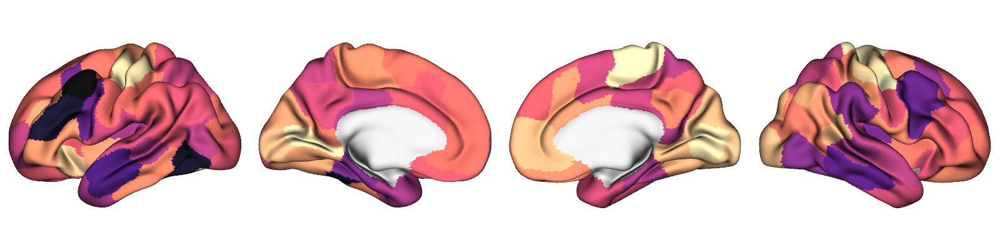

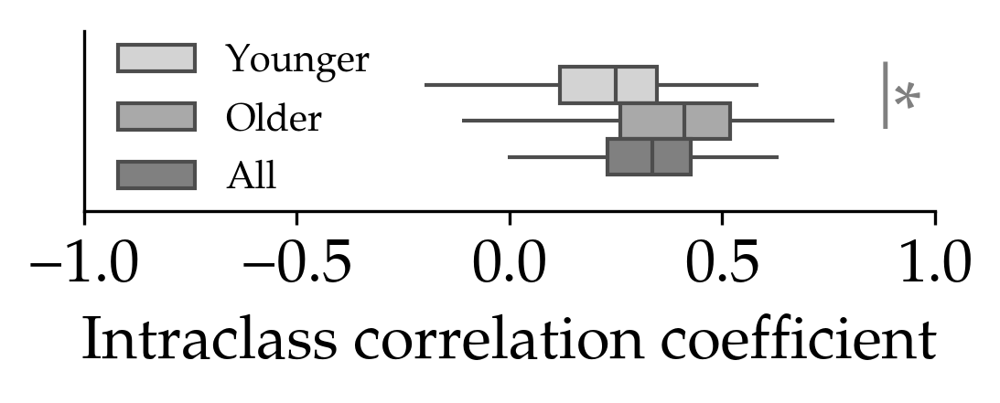

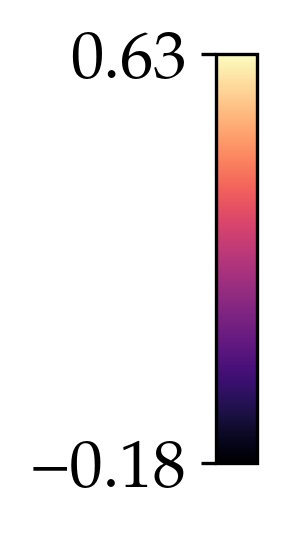

In [12]:
print(all_ICCs_by_age['sc_temp'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['sc_temp'], 'schaefer-100')

### (iv) Comparison of GOF

In [13]:
gof_labels = {    
    'gof': 'Goodness of fit',
    'fc_corr': 'FC correlation',
    'sc_fc': 'SC-FC coupling',
    'fc_diff': 'FC difference',
    'fcd_ks': 'FCD KS distance',
}

Goodness of fit	-8.226	0.0	-0.068	0.117
FC correlation	-13.072	0.0	-0.047	0.051
SC-FC coupling	20.228	0.0	0.031	0.022
FC difference	-2.741	0.007	-0.015	0.076
FCD KS distance	6.302	0.0	0.036	0.08


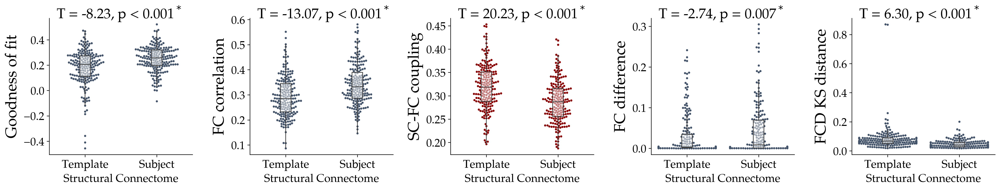

In [14]:
all_data['sc_temp']['SC'] = 'Template'
all_data['main']['SC'] = 'Subject'
data_combined = pd.concat([all_data['sc_temp'], all_data['main']], axis=0)
gof_measures = ['gof','fc_corr', 'sc_fc', 'fc_diff', 'fcd_ks']
fig, axd = plt.subplot_mosaic(
    [
        gof_measures,
    ],
    gridspec_kw=dict(width_ratios=[1]*5, height_ratios=[1]), 
    figsize=(20, 4)
)

for i, col in enumerate(gof_measures):
    label = gof_labels[col]
    ax = axd[col]
    if col == 'sc_fc':
        color = 'darkred'
    else:
        color= '#44546A'
    sns.swarmplot(
        data=data_combined,
        x='SC', y=col,
        s=3, color=color,
        ax=ax
    )
    sns.boxplot(
        data=data_combined,
        x='SC', y=col,
        showfliers=False,
        showcaps=False, width=0.15,
        boxprops={"facecolor": (1, 1, 1, 0.5)},
        ax=ax)
    plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
    ax.set_ylabel(label, fontsize=22)
    ax.set_xlabel('Structural Connectome')
    sns.despine()
    # add statistics
    alt = all_data['sc_temp'].loc[:, col]
    main = all_data['main'].loc[:, col]
    t, p = scipy.stats.ttest_rel(alt, main)
    if add_text:
        if p > 0.001:
            text = f'T = {t:.2f}, p = {p:.3f}'
        else:
            text = f'T = {t:.2f}, p < 0.001'
        if p < 0.05:
            text+=r'$^*$'
        text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
        text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
        ax.text(text_x, text_y, 
                text,
                color='black',
                size=20,
                multialignment='left')
    mean_diff = (alt - main).mean()
    sd_diff = (alt - main).std()
    print(label, round(t, 3), round(p,3), round(mean_diff,3), round(sd_diff,3), sep="\t")
fig.tight_layout(pad=1.0)

## S8A. Effect of age on E-I ratio controlled for SC strength

Calculate subject-specific SC strength maps:

In [15]:
sc_strength = pd.DataFrame(index=data.index, columns=parcels, dtype=float)
for sub in tqdm(data.index):
    sc = pd.read_csv(
        os.path.join(OUTPUT_DIR['pnc'], 'SC', sub, 
                     'ctx_parc-schaefer-100_mean001_thresh-1_desc-strength.csv.gz'),
        index_col=0)
    sc_strength.loc[sub, :] = sc.sum(axis=1)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [00:02<00:00, 88.22it/s]


Calculate age effects while controlling for SC strength:

In [16]:
df = pd.concat([all_I_E['main'], sc_strength, all_data['main']], axis=1)
df.columns = [f'IE_{i}' for i in range(100)] + [f'SC_{i}' for i in range(100)] + list(df.columns[200:])
df['sex_int'] = (df['sex'] == 'F').astype('int')

t = pd.Series(index=parcels)
r = pd.Series(index=parcels)
p = pd.Series(index=parcels)
Ns = pd.Series(index=parcels)
outliers = {}
for i, parc in enumerate(parcels):
    # exclude outliers
    curr_subs = df.index[(scipy.stats.zscore(df.loc[:, f'IE_{i}']).abs() < 3)]
    outliers[parc] = set(df.index) - set(curr_subs)
    model_df = df.loc[curr_subs]
    # fit the confound removal model to calculate pearson's r of the
    # residual of I_E with age as an easy-to-interpret effect size
    res_conf = smf.ols(f"IE_{i} ~ gof + sex + mean_rms + SC_{i}", data=model_df).fit()
    r.loc[parc] = scipy.stats.pearsonr(model_df["age"], res_conf.resid).statistic
    # fit the model
    mod = smf.ols(f'IE_{i} ~ age + gof + sex_int + mean_rms + SC_{i}', data=model_df)
    res = mod.fit()
    t.loc[parc] = res.tvalues['age']
    p.loc[parc] = res.pvalues['age']
    Ns.loc[parc] = len(curr_subs)

# FDR correction
_, p_fdr = statsmodels.stats.multitest.fdrcorrection(p)
p_fdr = pd.Series(p_fdr, index=parcels)

# display stats of signficant regions
stats_age_sc_conf = pd.DataFrame({"t": t, "r": r, "p": p, "p_fdr": p_fdr, "N": Ns})
stats_age_sc_conf.to_csv("p_pnc200_sc_conf_IE_age_stats.csv")
stats_age_sc_conf[stats_age_sc_conf["p_fdr"] < 0.05].sort_values(by="t").round(3)

,t,r,p,p_fdr,N
7Networks_RH_Cont_Par_1,-4.350,-0.291,0.000,0.002,198.0
7Networks_RH_Cont_PFCl_1,-4.250,-0.290,0.000,0.002,198.0
7Networks_RH_DorsAttn_Post_3,-3.586,-0.250,0.000,0.011,197.0
7Networks_RH_Default_Par_1,-3.547,-0.238,0.000,0.011,199.0
7Networks_LH_Cont_pCun_1,-3.511,-0.244,0.001,0.011,199.0
7Networks_RH_DorsAttn_Post_1,-3.342,-0.232,0.001,0.015,200.0
7Networks_RH_Cont_PFCl_2,-3.329,-0.230,0.001,0.015,199.0
7Networks_RH_Default_PFCdPFCm_2,-3.095,-0.219,0.002,0.028,193.0
7Networks_LH_DorsAttn_Post_5,-3.011,-0.210,0.003,0.030,195.0
7Networks_RH_SalVentAttn_TempOccPar_1,-3.002,-0.211,0.003,0.030,198.0


### (i) FDR-significant effects

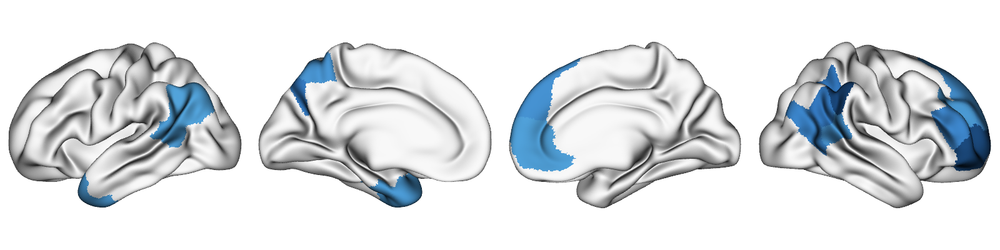

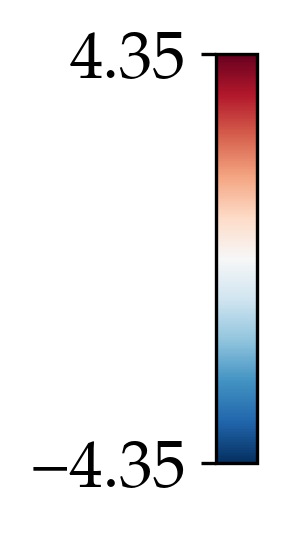

In [17]:
vmin = min(stats_age_sc_conf['t'].values.min(), -stats_age_sc_conf['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        stats_age_sc_conf['t'][stats_age_sc_conf['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

### (ii) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.9600232656644795 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.9765640216823538 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(Controlled for SC)', ylabel='E-I ratio age effect\n(Not controlled for SC)'>

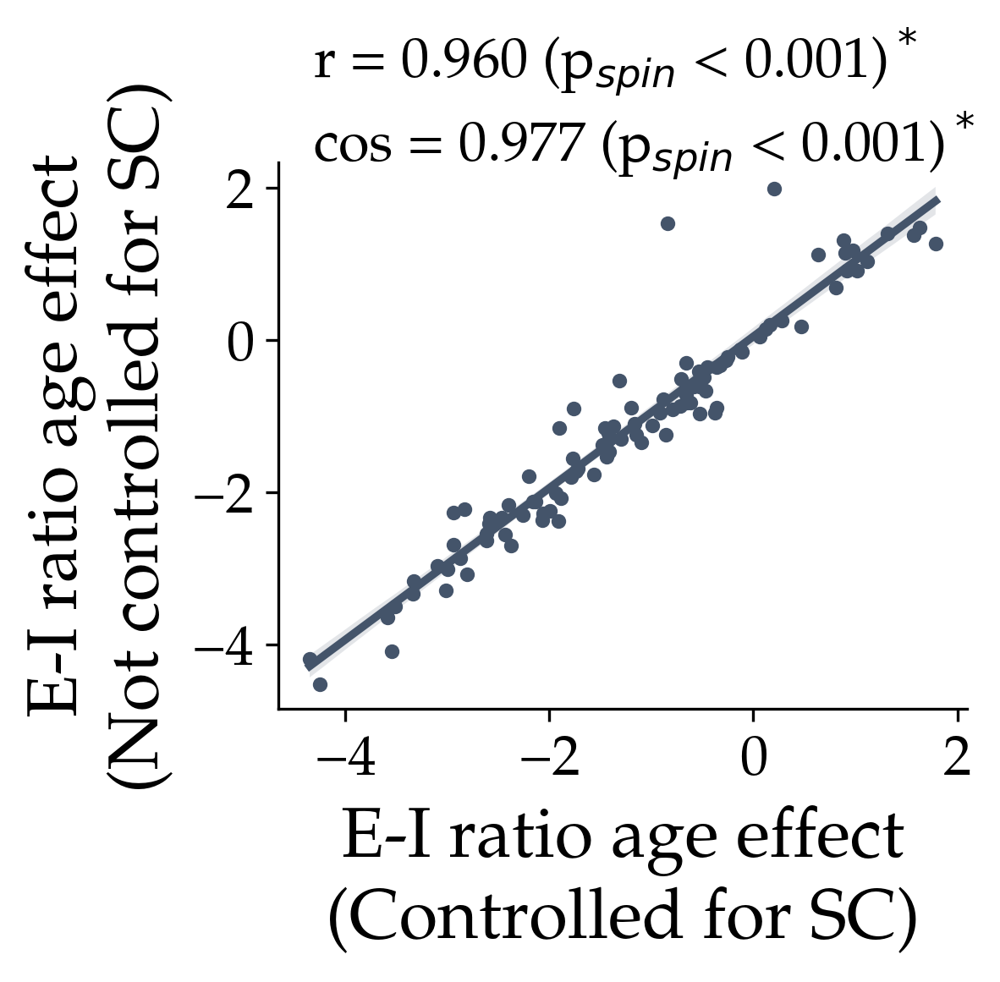

In [18]:
plot.reg_plot(
    stats_age_sc_conf[['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(Controlled for SC)',
    ylabel='E-I ratio age effect''\n(Not controlled for SC)'
)

# Figure 5C and S9. Robustness of the findings to the effect of parcellation using Schaefer-200

## 5C. Effect of age on E-I ratio using Schaefer-200 parcellation (unthresholded)

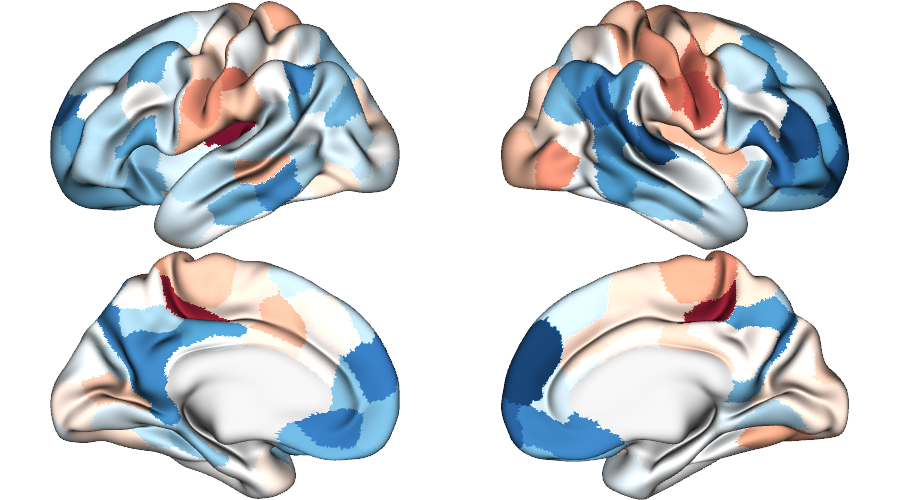

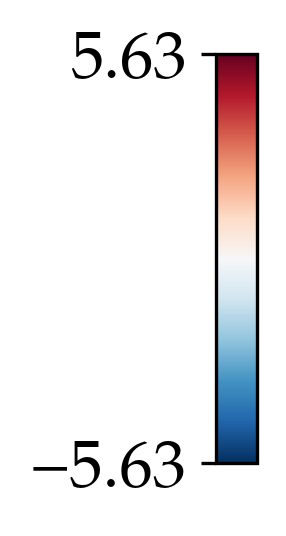

In [19]:
vmin = min(all_stats['sch200']['t'].values.min(), -all_stats['sch200']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['sch200']['t'], 'schaefer-200', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

## S9A. Effect of age on E-I ratio using Schaefer-200 parcellation

### (left) FDR-significant effects

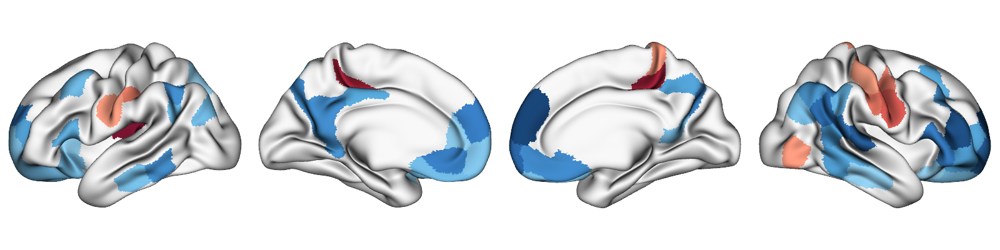

In [20]:
vmin = min(all_stats['sch200']['t'].values.min(), -all_stats['sch200']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['sch200']['t'][all_stats['sch200']['p_fdr']<0.05], 
        'schaefer-200', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (right) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.5964101029742513 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.6154152983516191 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(Schaefer-200)', ylabel='E-I ratio age effect\n(Schaefer-100)'>

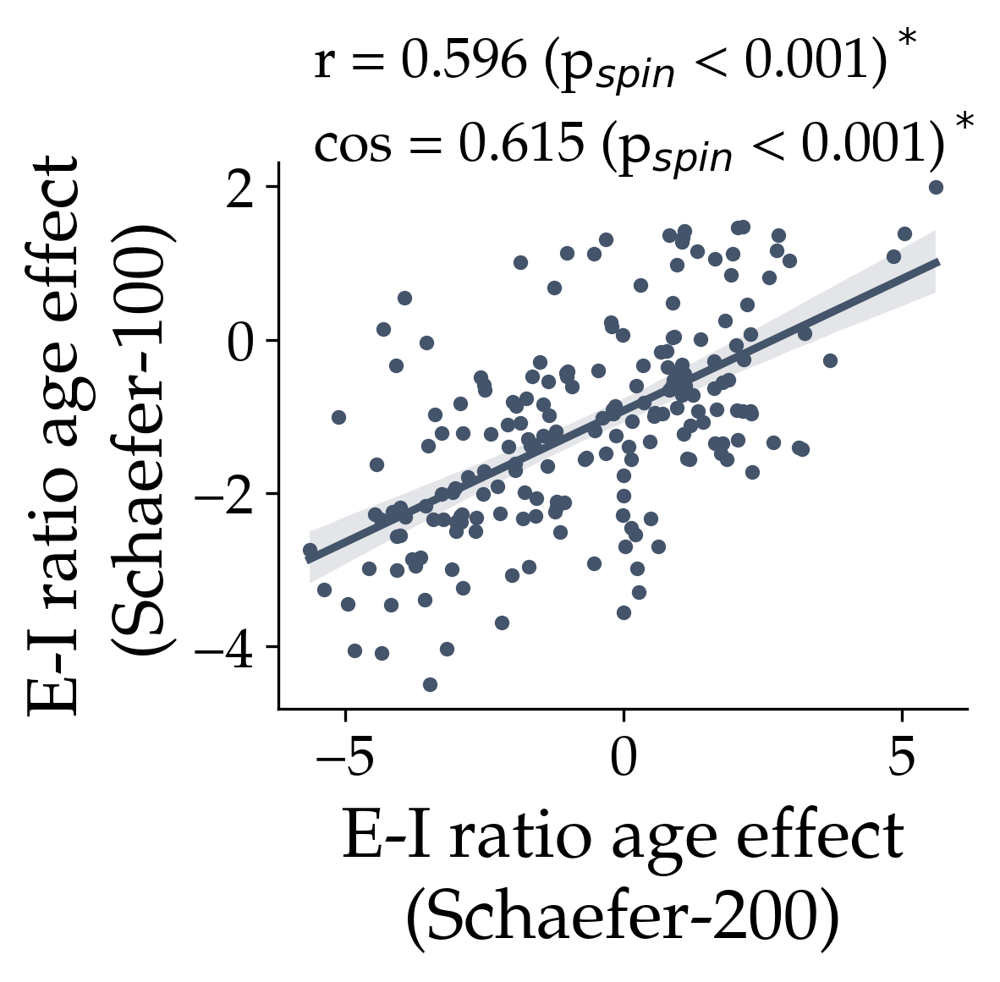

In [21]:
# project main age effect map from sch100->vertices->sch200
t_age_main_reparc_sch200 = transform.parcellate_surf(
    transform.deparcellate_surf(
        all_stats['main']['t'], 'schaefer-100'
    ), 'schaefer-200', concat=True).iloc[:, 0]
plot.reg_plot(
    all_stats['sch200'][['t']], t_age_main_reparc_sch200.to_frame(), 'schaefer-200',
    xlabel='E-I ratio age effect''\n(Schaefer-200)',
    ylabel='E-I ratio age effect''\n(Schaefer-100)'
)

## S9B. ICC

       younger    older      all
count  200.000  200.000  200.000
mean     0.347    0.333    0.356
std      0.206    0.209    0.186
min     -0.305   -0.229   -0.075
25%      0.228    0.186    0.232
50%      0.378    0.354    0.381
75%      0.486    0.472    0.486
max      0.832    0.883    0.836
T =0.903649241229275, p = 0.367274008964672


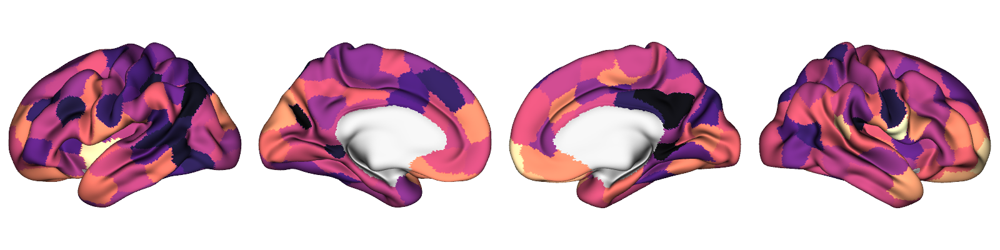

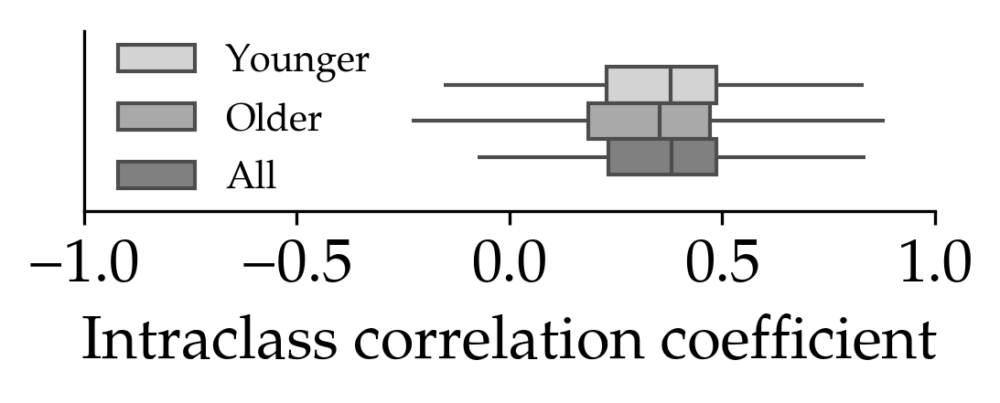

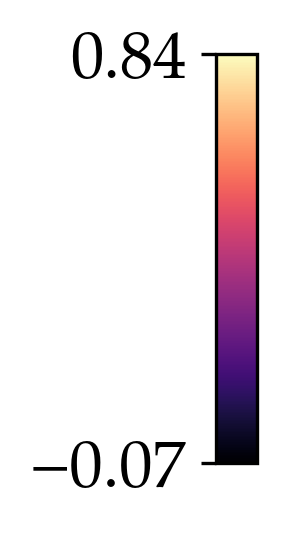

In [22]:
print(all_ICCs_by_age['sch200'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['sch200'], 'schaefer-200')

## S9C. Comparison of GOF

Goodness of fit	-15.406	0.0	-0.054	0.05
FC correlation	-7.632	0.0	-0.022	0.04
SC-FC coupling	-25.835	0.0	-0.034	0.019
FC difference	2.405	0.017	0.006	0.034
FCD KS distance	16.434	0.0	0.027	0.023


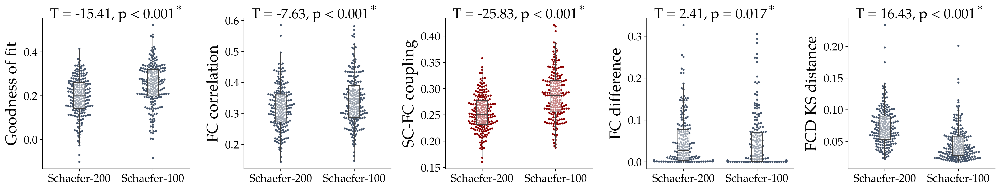

In [23]:
all_data['sch200']['Parcellation'] = 'Schaefer-200'
all_data['main']['Parcellation'] = 'Schaefer-100'
data_combined = pd.concat([all_data['sch200'], all_data['main']], axis=0)
gof_measures = ['gof','fc_corr', 'sc_fc', 'fc_diff', 'fcd_ks']
fig, axd = plt.subplot_mosaic(
    [
        gof_measures,
    ],
    gridspec_kw=dict(width_ratios=[1]*5, height_ratios=[1]), 
    figsize=(20, 4)
)

for i, col in enumerate(gof_measures):
    label = gof_labels[col]
    ax = axd[col]
    if col == 'sc_fc':
        color = 'darkred'
    else:
        color= '#44546A'
    sns.swarmplot(
        data=data_combined,
        x='Parcellation', y=col,
        s=3, color=color,
        ax=ax
    )
    sns.boxplot(
        data=data_combined,
        x='Parcellation', y=col,
        showfliers=False,
        showcaps=False, width=0.15,
        boxprops={"facecolor": (1, 1, 1, 0.5)},
        ax=ax)
    plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
    ax.set_ylabel(label, fontsize=22)
    ax.set_xlabel('')
    sns.despine()
    # add statistics
    alt = all_data['sch200'].loc[:, col]
    main = all_data['main'].loc[:, col]
    t, p = scipy.stats.ttest_rel(alt, main)
    if add_text:
        if p > 0.001:
            text = f'T = {t:.2f}, p = {p:.3f}'
        else:
            text = f'T = {t:.2f}, p < 0.001'
        if p < 0.05:
            text+=r'$^*$'
        text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
        text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
        ax.text(text_x, text_y, 
                text,
                color='black',
                size=20,
                multialignment='left')
    mean_diff = (alt - main).mean()
    sd_diff = (alt - main).std()
    print(label, round(t, 3), round(p,3), round(mean_diff,3), round(sd_diff,3), sep="\t")
fig.tight_layout(pad=1.0)

# Figure 5D and S10. Robustness of the findings to the effect of regional parameter heterogeneity maps

Note: Alternative sets of maps were created using the following code:

```python
maps = datasets.load_maps('schaefer-100', '6maps')
np.savetxt(
    os.path.join(INPUT_DIR, '2maps_schaefer-100_zscore.txt'), 
    maps.loc[:, ['myelinmap', 'fcgradient01']].values.T, fmt="%f"
)
np.savetxt(
    os.path.join(INPUT_DIR, 'nmda_gabaa_schaefer-100_zscore.txt'), 
    maps.loc[:, ['nmda', 'gabaa']].values.T, fmt="%f"
)
np.savetxt(
    os.path.join(INPUT_DIR, 'nmda_gabaa_schaefer-100_zscore.txt'), 
    maps.loc[:, ['myelinmap', 'fcgradient01', 'nmda', 'gabaa']].values.T, fmt="%f"
)
```

## 5C. Effect of age on E-I ratio using alternative sets of maps (unthresholded)

### (left) T1w/T2w & FC G1

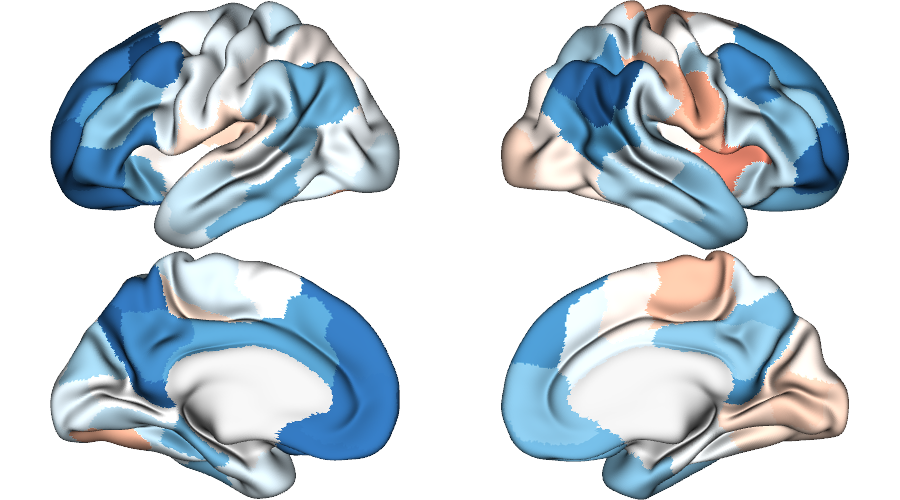

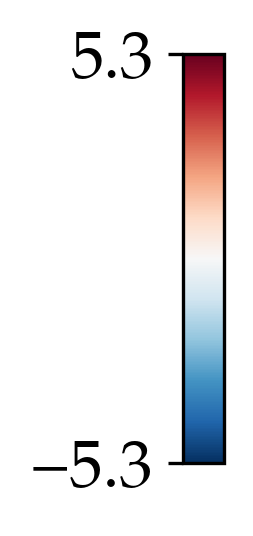

In [24]:
vmin = min(all_stats['2maps']['t'].values.min(), -all_stats['2maps']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['2maps']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

### (middle) NMDA & GABA$_{A/BZ}$

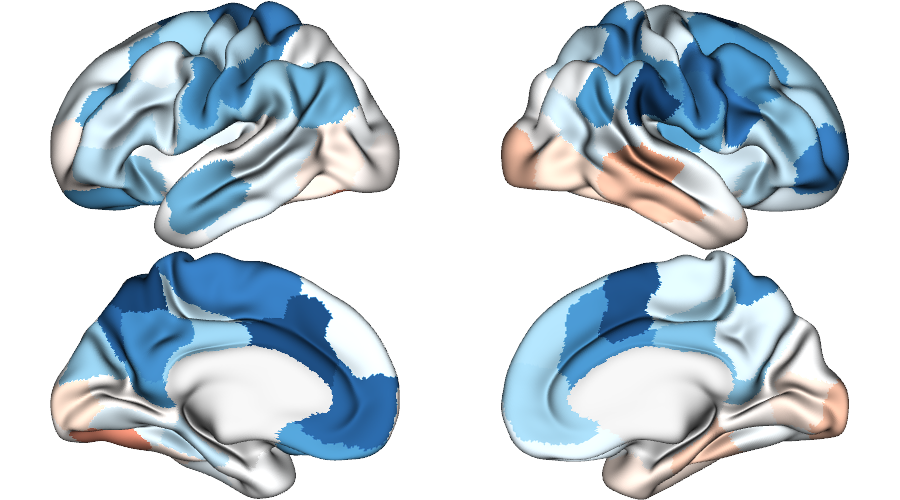

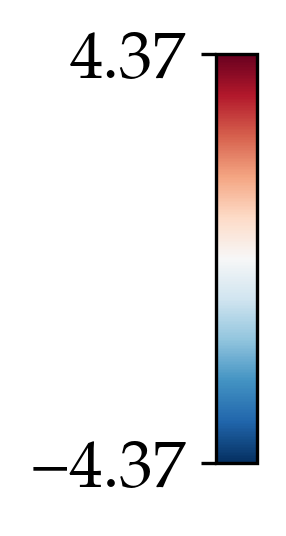

In [25]:
vmin = min(all_stats['nmda_gabaa']['t'].values.min(), -all_stats['nmda_gabaa']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['nmda_gabaa']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

### (right) T1w/T2w, FC G1, NMDA & GABA$_{A/BZ}$

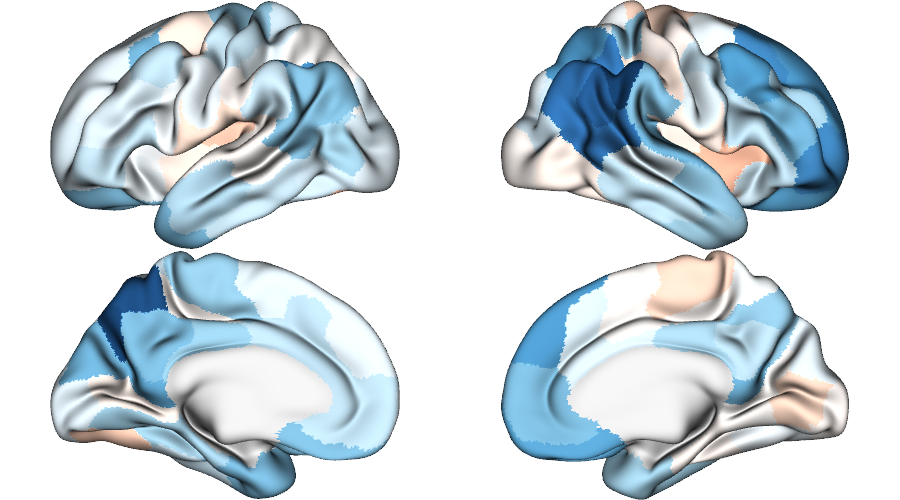

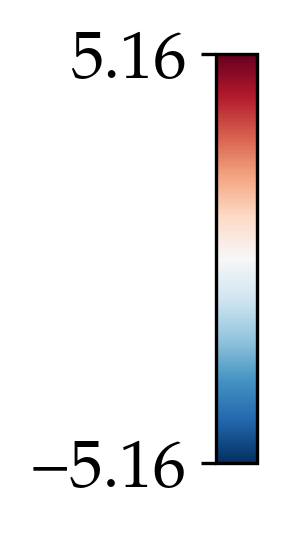

In [26]:
vmin = min(all_stats['4maps']['t'].values.min(), -all_stats['4maps']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['4maps']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

## S10A. Effect of age on E-I ratio using T1w/T2w & FC G1 maps

### (i) FDR-significant effects

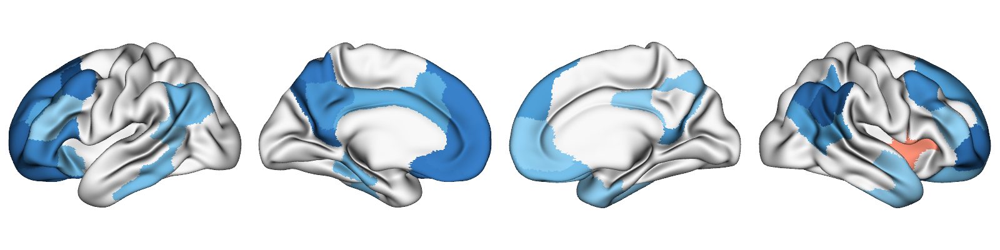

In [27]:
vmin = min(all_stats['2maps']['t'].values.min(), -all_stats['2maps']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['2maps']['t'][all_stats['2maps']['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (ii) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.776217832738688 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.8628437144031454 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(T1w/T2w & FC G1)', ylabel='E-I ratio age effect\n(Six maps)'>

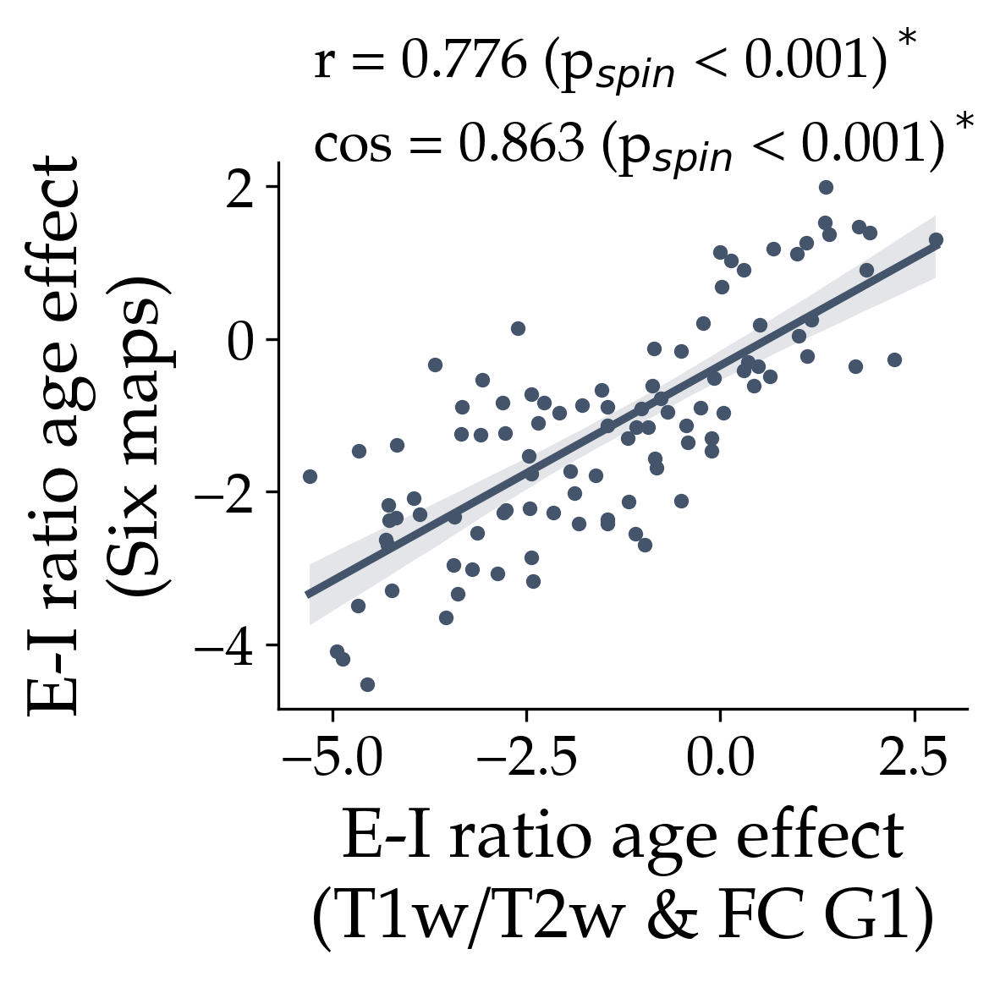

In [28]:
plot.reg_plot(
    all_stats['2maps'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(T1w/T2w & FC G1)',
    ylabel='E-I ratio age effect''\n(Six maps)'
)

### (iii) ICC

       younger    older      all
count  100.000  100.000  100.000
mean     0.671    0.692    0.698
std      0.109    0.150    0.108
min      0.321    0.004    0.183
25%      0.602    0.626    0.627
50%      0.684    0.713    0.715
75%      0.751    0.785    0.775
max      0.867    0.922    0.881
T =-1.4645697903972865, p = 0.14620673990105323


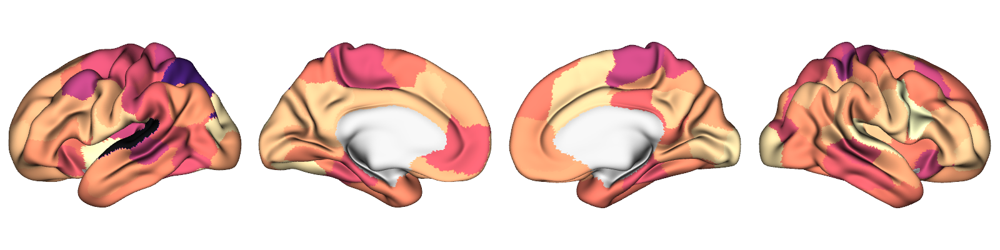

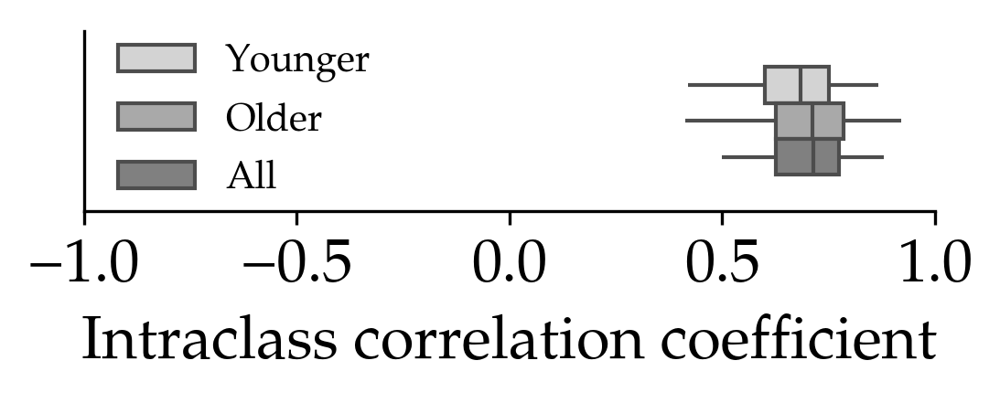

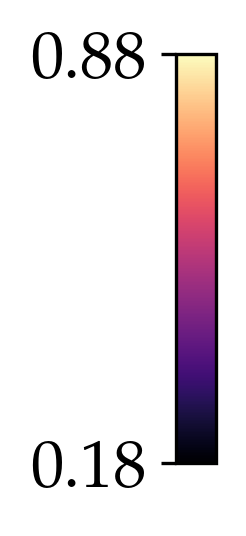

In [29]:
print(all_ICCs_by_age['2maps'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['2maps'], 'schaefer-100')

## S10B. Effect of age on E-I ratio using NMDA & GABA$_{A/BZ}$

### (i) FDR-significant effects

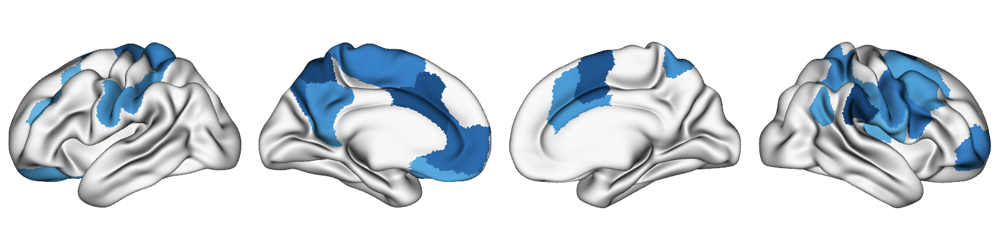

In [30]:
vmin = min(all_stats['nmda_gabaa']['t'].values.min(), -all_stats['nmda_gabaa']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['nmda_gabaa']['t'][all_stats['nmda_gabaa']['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (ii) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.33051937532872866 ; p-vlaue: 0.001
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.6303135241683572 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(NMDA & GABA$_{A/BZ}$)', ylabel='E-I ratio age effect\n(Six maps)'>

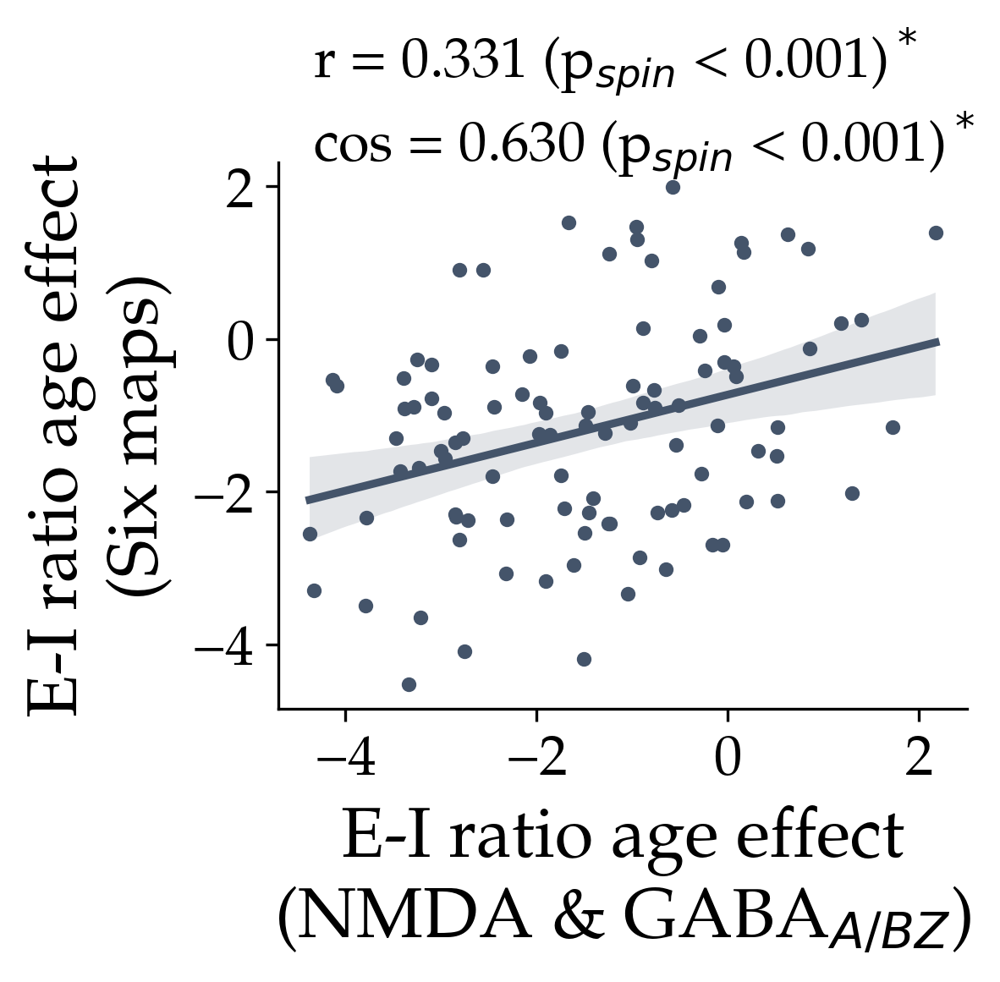

In [31]:
plot.reg_plot(
    all_stats['nmda_gabaa'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(NMDA & GABA$_{A/BZ}$)',
    ylabel='E-I ratio age effect''\n(Six maps)'
)

### (iii) ICC

       younger    older      all
count  100.000  100.000  100.000
mean     0.469    0.547    0.530
std      0.166    0.160    0.133
min      0.035    0.174    0.203
25%      0.359    0.433    0.434
50%      0.489    0.573    0.549
75%      0.602    0.665    0.619
max      0.765    0.838    0.795
T =-4.968667789000551, p = 2.8243198008038203e-06


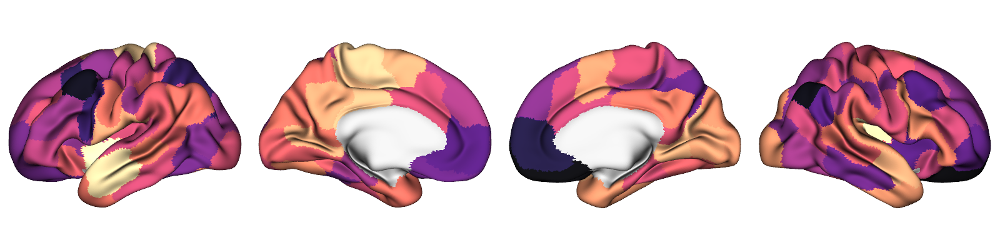

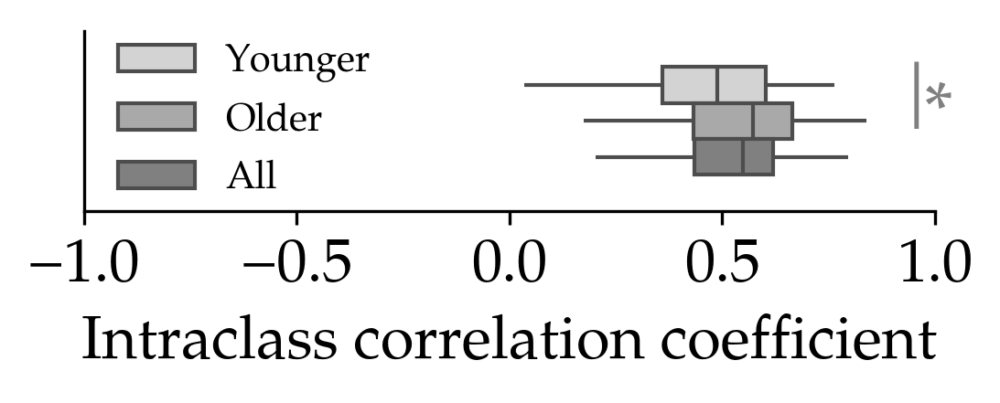

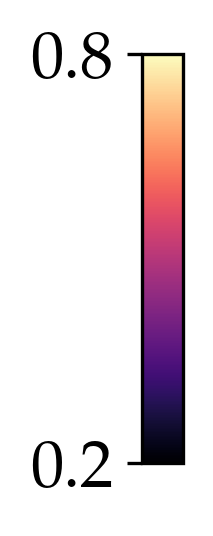

In [32]:
print(all_ICCs_by_age['nmda_gabaa'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['nmda_gabaa'], 'schaefer-100')

## S10C. Effect of age on E-I ratio using T1w/T2w, FC G1, NMDA & GABA$_{A/BZ}$

### (i) FDR-significant effects

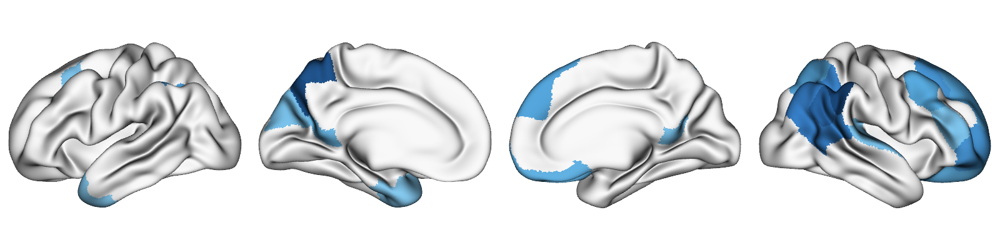

In [33]:
vmin = min(all_stats['4maps']['t'].values.min(), -all_stats['4maps']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['4maps']['t'][all_stats['4maps']['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (ii) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.8534980001933581 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.9156989396323226 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(Four maps)', ylabel='E-I ratio age effect\n(Six maps)'>

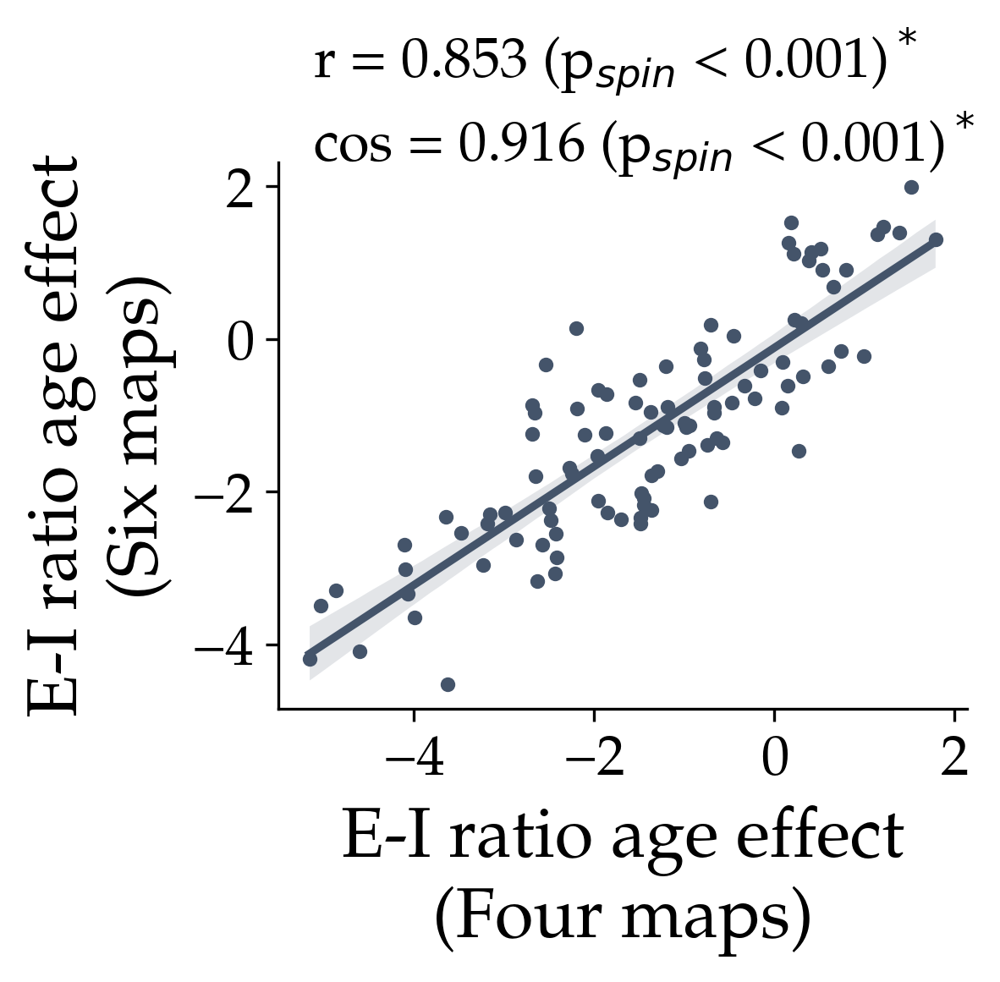

In [34]:
plot.reg_plot(
    all_stats['4maps'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(Four maps)',
    ylabel='E-I ratio age effect''\n(Six maps)'
)

### (iii) ICC

       younger    older      all
count  100.000  100.000  100.000
mean     0.786    0.828    0.819
std      0.076    0.092    0.068
min      0.573    0.260    0.483
25%      0.745    0.798    0.788
50%      0.799    0.844    0.830
75%      0.834    0.880    0.866
max      0.942    0.946    0.931
T =-4.651579530078343, p = 1.0207695995791003e-05


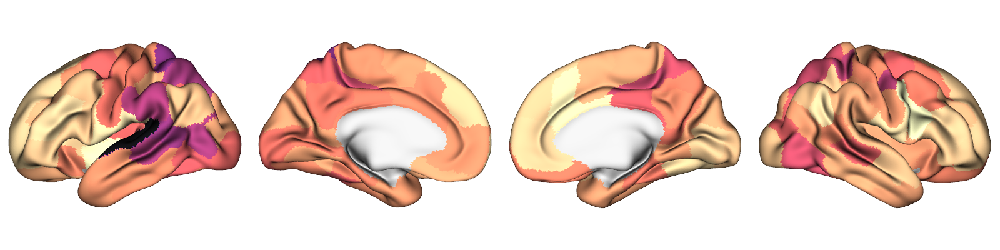

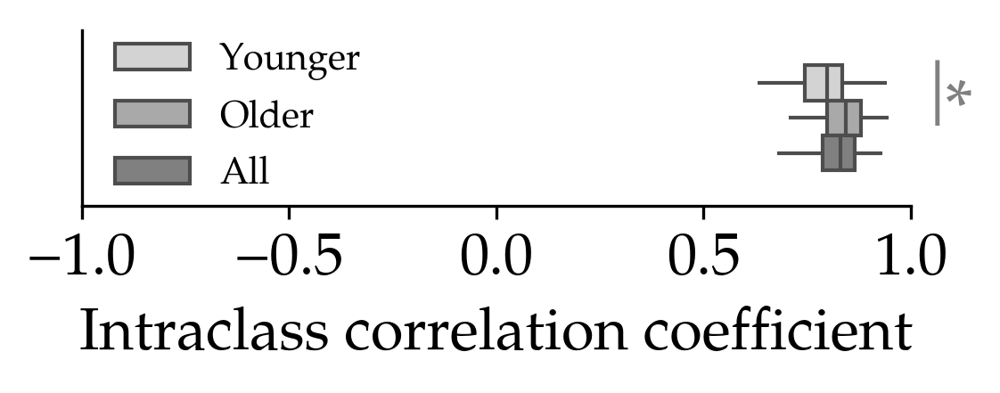

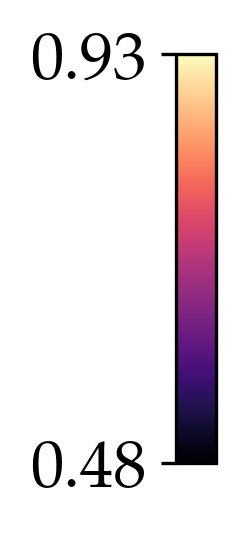

In [35]:
print(all_ICCs_by_age['4maps'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['4maps'], 'schaefer-100')

## S10D. Comparison of GOF using alternative subsets of heterogeneity maps

Goodness of fit: 4maps - main: t = -10.416, p = 0.0, mean_diff = -0.018, sd_diff = 0.024
Goodness of fit: 2maps - main: t = -17.998, p = 0.0, mean_diff = -0.044, sd_diff = 0.034
Goodness of fit: nmda_gabaa - main: t = -18.259, p = 0.0, mean_diff = -0.068, sd_diff = 0.053
FC correlation: 4maps - main: t = -6.94, p = 0.0, mean_diff = -0.009, sd_diff = 0.019
FC correlation: 2maps - main: t = -11.289, p = 0.0, mean_diff = -0.023, sd_diff = 0.028
FC correlation: nmda_gabaa - main: t = -14.361, p = 0.0, mean_diff = -0.04, sd_diff = 0.039
FC difference: 4maps - main: t = 2.838, p = 0.005, mean_diff = 0.006, sd_diff = 0.029
FC difference: 2maps - main: t = 7.292, p = 0.0, mean_diff = 0.014, sd_diff = 0.026
FC difference: nmda_gabaa - main: t = 9.08, p = 0.0, mean_diff = 0.022, sd_diff = 0.035
FCD KS distance: 4maps - main: t = 1.644, p = 0.102, mean_diff = 0.003, sd_diff = 0.024
FCD KS distance: 2maps - main: t = 5.289, p = 0.0, mean_diff = 0.008, sd_diff = 0.021
FCD KS distance: nmda_gabaa - 

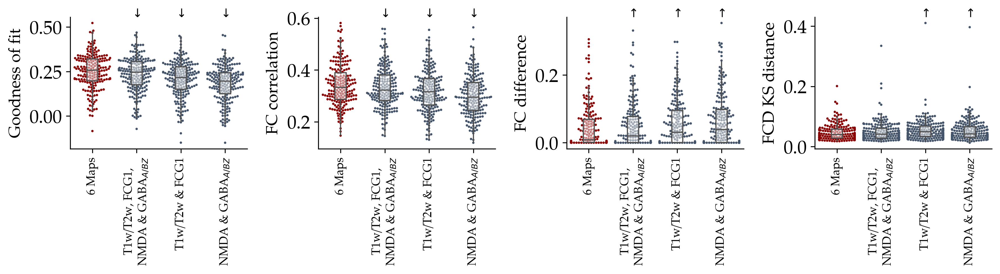

In [36]:
altmaps = ['main', '4maps', '2maps', 'nmda_gabaa']
altmap_labels = ['6 Maps', 'T1w/T2w, FCG1,\nNMDA & GABA$_{A/BZ}$', 'T1w/T2w & FCG1', r'NMDA & GABA$_{A/BZ}$']
data_het_combined = []
for alt in altmaps:
    all_data[alt]['Maps'] = alt
    data_het_combined.append(all_data[alt].loc[:, ['gof', 'fc_corr', 'fcd_ks', 'fc_diff', 'Maps']])
data_het_combined = pd.concat(data_het_combined, axis=0)
gof_measures = ['gof','fc_corr', 'fc_diff', 'fcd_ks']
fig, axd = plt.subplot_mosaic(
    [gof_measures],
    gridspec_kw=dict(width_ratios=[1]*4, height_ratios=[1]), 
    figsize=(12, 3.5)
)

for i, col in enumerate(gof_measures):
    label = gof_labels[col]
    ax = axd[col]
    sns.swarmplot(
        data=data_het_combined,
        x='Maps', y=col, order=altmaps,
        s=2, palette=['darkred']+[thcolor]*6,
        ax=ax
    )
    sns.boxplot(
        data=data_het_combined,
        x='Maps', y=col, order=altmaps,
        showfliers=False,
        showcaps=False, width=0.25,
        boxprops={"facecolor": (1, 1, 1, 0.5)},
        ax=ax)
    plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
    ax.set_ylabel(label, fontsize=14)
    ax.set_xlabel('')
    ax.set_xticklabels(altmap_labels, rotation=90, fontsize=10)
    sns.despine()
    # statistics
    for j, alt in enumerate(altmaps[1:]):
        t, p = scipy.stats.ttest_rel(
            data_het_combined.loc[data_het_combined['Maps']==alt, col],
            data_het_combined.loc[data_het_combined['Maps']=='main', col]
        )
        if p < 0.05:
            text_x = j+0.85
            text_y = ax.get_ylim()[1]
            if t < 0:
                text = r'$\downarrow$'
            else:
                text = r'$\uparrow$'
            # text = '*'
            ax.text(text_x, text_y, text, fontsize=10, multialignment='center')
        mean_diff = (
            data_het_combined.loc[data_het_combined['Maps']==alt, col] - 
            data_het_combined.loc[data_het_combined['Maps']=='main', col]
        ).mean()
        sd_diff = (
            data_het_combined.loc[data_het_combined['Maps']==alt, col] - 
            data_het_combined.loc[data_het_combined['Maps']=='main', col]
        ).std()
        print(f"{label}: {alt} - main: t = {round(t, 3)}, p = {round(p,3)}, mean_diff = {round(mean_diff, 3)}, sd_diff = {round(sd_diff, 3)}")
fig.tight_layout(pad=1.0)

# Figure S11. Comparison of models using true, null, or no maps

## S11A. Influence of selected maps patterns on the spatial pattern of E-I ratio age effects

Load original maps:

In [37]:
maps_parcellated = datasets.load_maps('schaefer-100', '6maps')

Create a set of null (rotated) maps:

In [38]:
# generate spin rotated parcel indices
rotated_indices = stats.get_rotated_parcels('schaefer-100', 1, return_indices=True, space='fsaverage', seed=0).flatten()
# rotate all original maps using the rotation
# indices to create a set of surrogate maps
surrogate_maps = np.zeros(maps_parcellated.shape)
surrogate_maps[rotated_indices, :] = maps_parcellated.values
surrogate_maps = pd.DataFrame(surrogate_maps, index=maps_parcellated.index, columns=maps_parcellated.columns)

Plot the surrogate maps (for sanity check; they are not put in the figure):

myelinmap surrogate


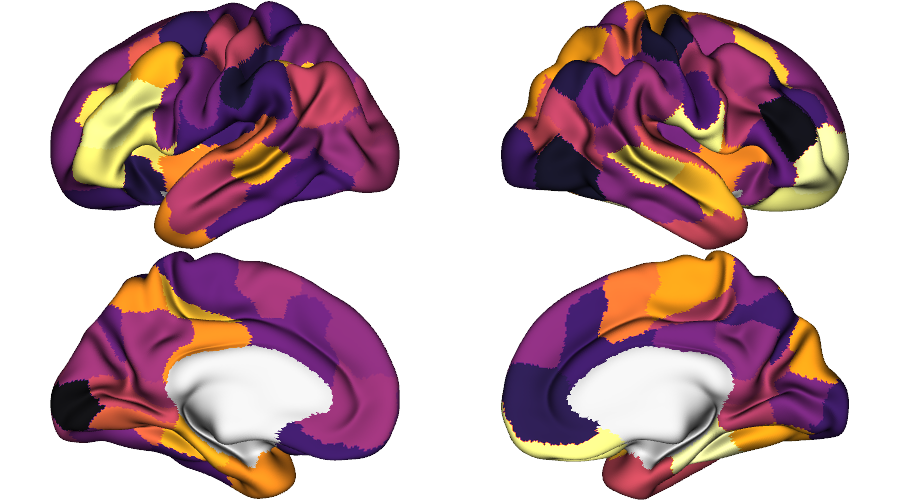

thickness surrogate


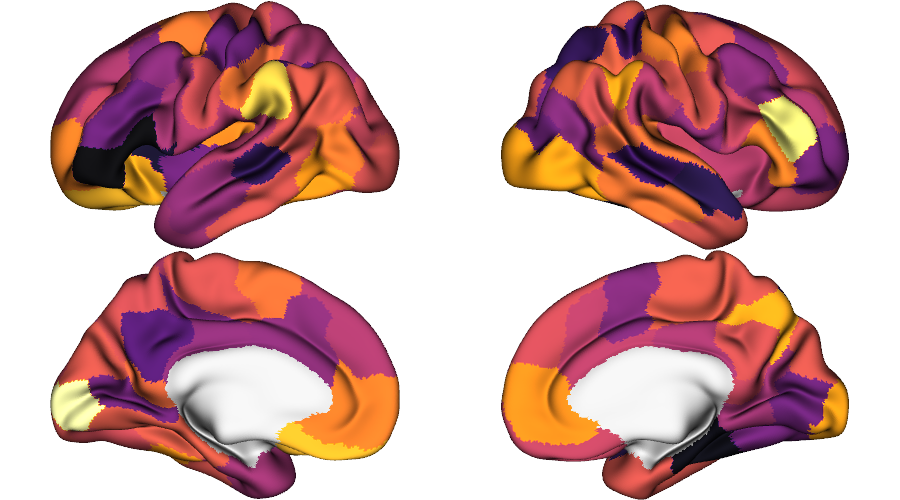

fcgradient01 surrogate


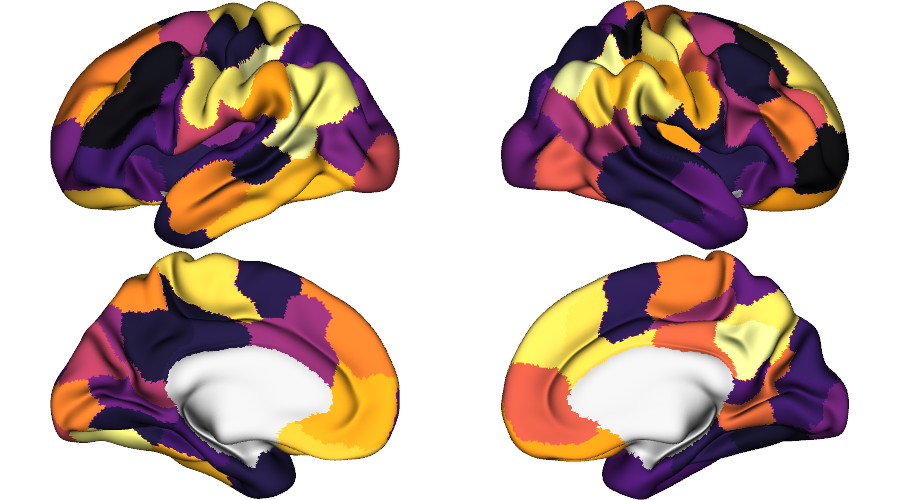

genepc1 surrogate


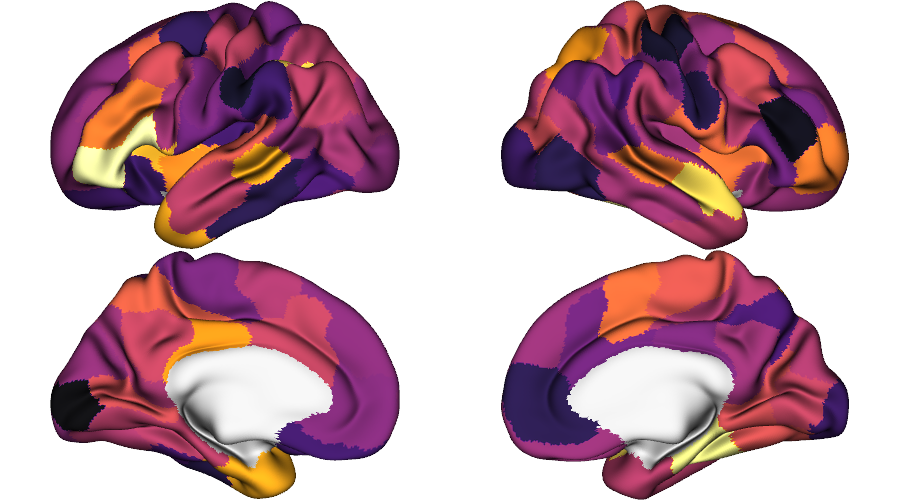

nmda surrogate


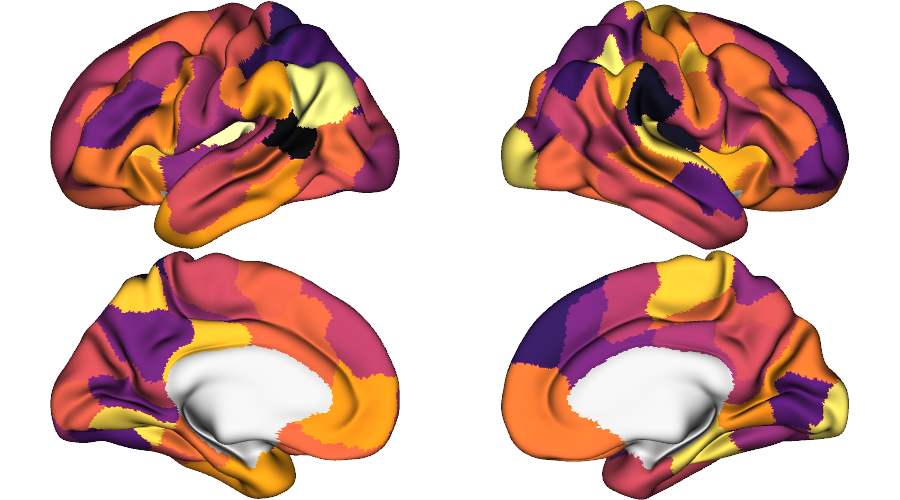

gabaa surrogate


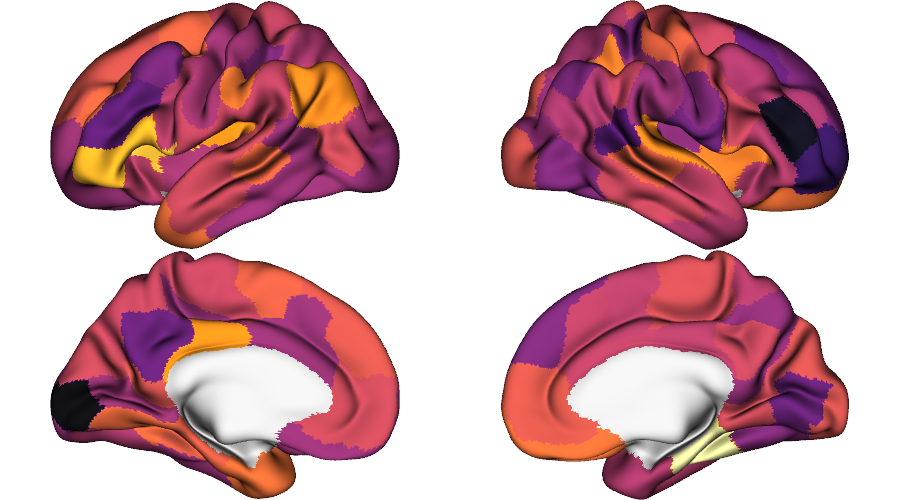

In [39]:
for col in surrogate_maps.columns:
    print(col, "surrogate")
    display(
        plot.plot_surface(
            transform.deparcellate_surf(surrogate_maps[col], 'schaefer-100', concat=True, space='fsaverage'), 
            'fsaverage', mesh_kind='semi-inflated',
            cmap='inferno', cbar=False, layout_style='grid',
        )
    )

Write them to a text file which is used in BNM simulation-optimization runs on the subsample subjects based on these null maps:

In [40]:
np.savetxt(os.path.join(INPUT_DIR, '6maps_rot_schaefer-100_zscore.txt'), surrogate_maps.values.T, fmt="%f")

The data of optimal simulations based on these runs is already loaded at the beginning of this notebook.

### (left) Effect of age on E-I ratio using null maps

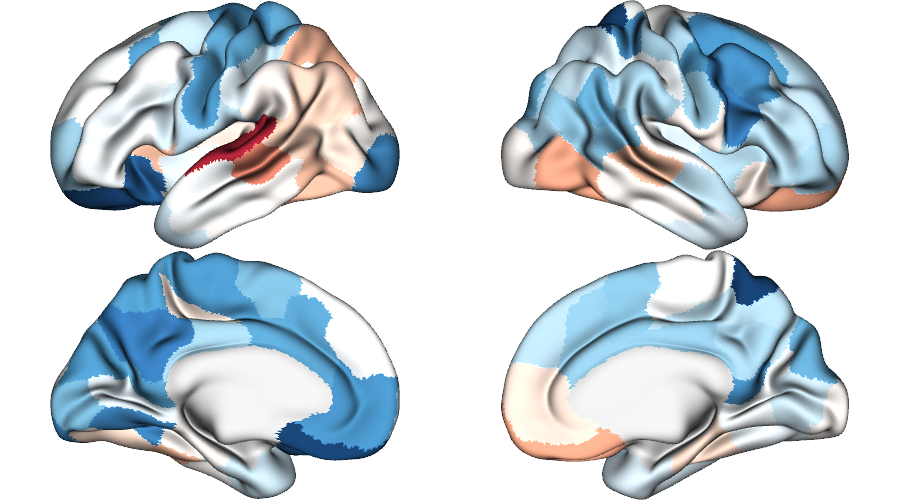

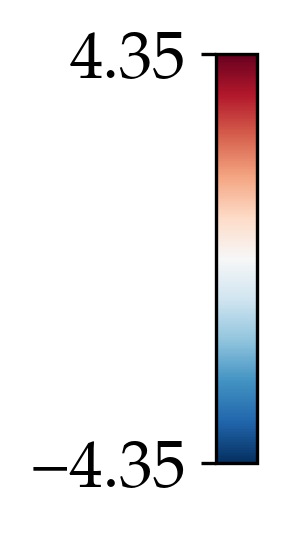

In [41]:
vmin = min(all_stats['6maps_rot']['t'].values.min(), -all_stats['6maps_rot']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['6maps_rot']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

Comparison with main age effect map (the plot is not reported in the figure):

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.21389570519110998 ; p-vlaue: 0.018
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.5026404412707627 ; p-vlaue: 0.009


<Axes: xlabel='E-I ratio age effect\n(Null maps)', ylabel='E-I ratio age effect\n(True maps)'>

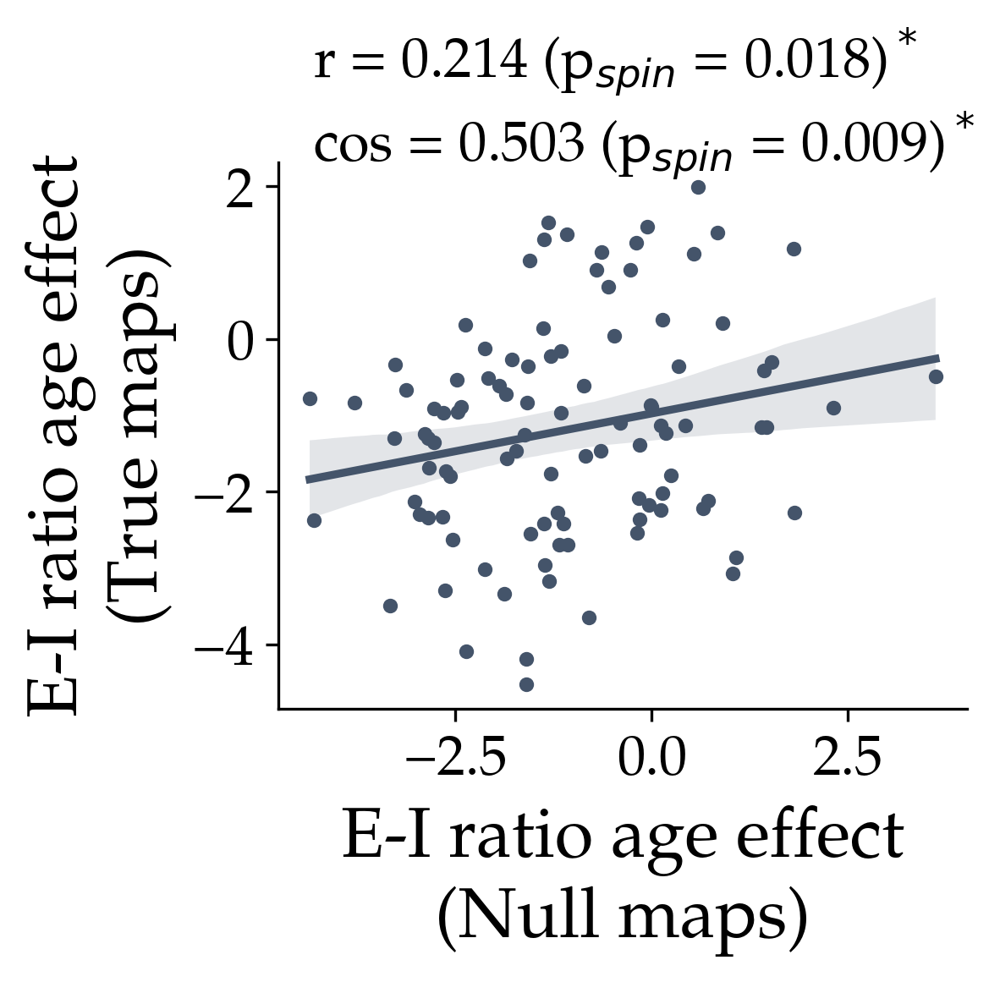

In [42]:
plot.reg_plot(
    all_stats['6maps_rot'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(Null maps)',
    ylabel='E-I ratio age effect''\n(True maps)'
)

### (right) Spatial correlation of true and null maps with the E-I ratio age effects observed across models using alternative maps/approaches for regional parameters heterogeneity

In [126]:
# define alternatives used in this analysis
het_alts = ['main', '6maps_rot', '4maps', '2maps', 'nmda_gabaa', 'homo', 'node']
het_alt_labels = ['6 Maps', '6 Null Maps', 'T1w/T2w, FCG1,\nNMDA & GABA$_{A/BZ}$', 'T1w/T2w & FCG1', r'NMDA & GABA$_{A/BZ}$', 'Homogeneous', 'Node-based\nheterogeneous']
# combine all T maps
ts_het = pd.DataFrame({k:all_stats[k]['t'] for k in het_alts})
# rename true and null map columns to print names
map_names = [
    "T1w/T2w",
    "Thickness",
    "FC G1",
    "Gene PC1",
    "NMDA",
    r"GABA$_{A/BZ}$"
]
maps_parcellated.columns = map_names
surrogate_maps.columns = [f'Rotated {map_name}' for map_name in map_names]
# calculate correlations of all alternatives with the six true maps
corr_het, p_corr_het, _ = stats.spin_test_parcellated(maps_parcellated, ts_het, parcellation_name='schaefer-100')
# calculate correlations of main and 6maps_rot age effects with the six null maps
null_corr_het, p_null_corr_het, _ = stats.spin_test_parcellated(surrogate_maps, ts_het.iloc[:, :2], parcellation_name='schaefer-100')

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000


Plot the correlations as a combined heatmap:

Text(7.5, 3, 'Null (rotated) maps')

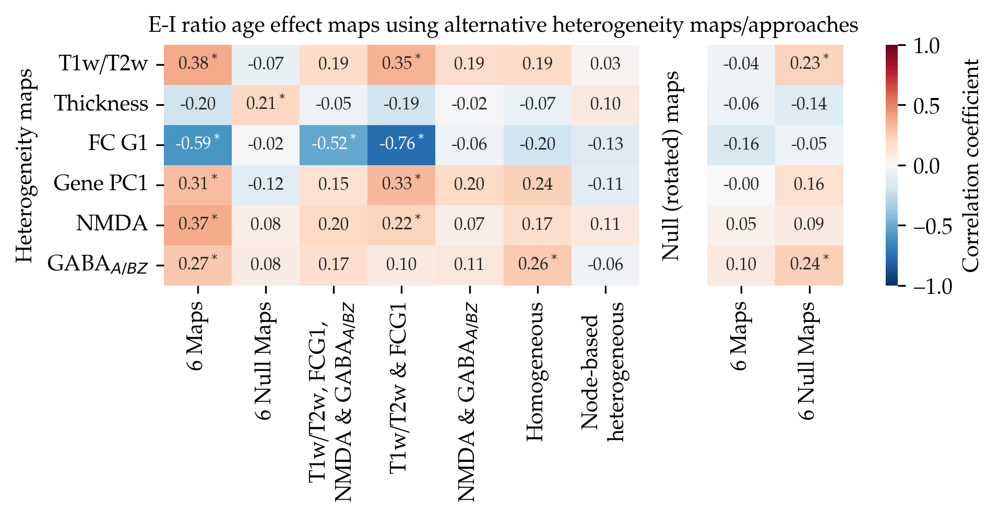

In [127]:
corr_het_combined = pd.concat([
    corr_het.T.reset_index(drop=True), 
    pd.DataFrame(np.full(6, np.NaN)), # adds an empty column for the space to write "Null (rotated) maps"
    null_corr_het.T.reset_index(drop=True)
],axis=1, ignore_index=True
)
p_corr_het_combined = pd.concat([
    p_corr_het.T.reset_index(drop=True), 
    pd.DataFrame(np.full(6, np.NaN)), 
    p_null_corr_het.T.reset_index(drop=True).iloc[:, :2]
],axis=1, ignore_index=True
)
# annotation of each cell as r + p +/- significance indicator
annot = corr_het_combined.applymap(lambda c: f'{c:.2f}') + p_corr_het_combined.applymap(lambda c: r'$^*$' if c<0.05 else '')

# plot
fig, ax = plt.subplots(figsize=(7, 2))
sns.heatmap(corr_het_combined,
            annot=annot, fmt='s', annot_kws=dict(fontsize=8),
            cmap='RdBu_r',  
            xticklabels=het_alt_labels+['']+het_alt_labels[:2], 
            yticklabels=map_names,
            vmin=-1, vmax=1,
            ax=ax, 
            )
# remove the tick of the empty column
ax.set_xticks(np.array(list(range(7))+list(range(8,10)))+0.5)
ax.set_xticklabels(het_alt_labels+het_alt_labels[:2], fontsize=10)
# aesthetics
ax.set_yticklabels(ax.get_yticklabels(), fontsize=10)
# ax.set_xlabel(r'E-I ratio age effect maps', fontsize=12)
ax.set_xlabel('')
ax.set_title('E-I ratio age effect maps using alternative heterogeneity maps/approaches', fontsize=10)
ax.set_ylabel('Heterogeneity maps', fontsize=10)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=10) 
cbar.set_label('Correlation coefficient', fontsize=10)
# add y-label of the null age effect correlations as a text object
ax.text(
    7.5, 3, 'Null (rotated) maps',
    fontsize=10, color='black', rotation='vertical', ha='center', va='center',
)

## S11B. Comparison of GOF in map-based versus null and map-free models

Goodness of fit: 6maps_rot - main: t = -5.442, p = 0.0, mean_diff = -0.018, sd_diff = 0.048
Goodness of fit: node - main: t = -12.106, p = 0.0, mean_diff = -0.059, sd_diff = 0.069
Goodness of fit: homo - main: t = -25.674, p = 0.0, mean_diff = -0.113, sd_diff = 0.062
FC correlation: 6maps_rot - main: t = -10.962, p = 0.0, mean_diff = -0.026, sd_diff = 0.034
FC correlation: node - main: t = -6.777, p = 0.0, mean_diff = -0.016, sd_diff = 0.034
FC correlation: homo - main: t = -18.504, p = 0.0, mean_diff = -0.062, sd_diff = 0.048
FC difference: 6maps_rot - main: t = -1.772, p = 0.078, mean_diff = -0.004, sd_diff = 0.029
FC difference: node - main: t = 5.761, p = 0.0, mean_diff = 0.02, sd_diff = 0.049
FC difference: homo - main: t = 13.435, p = 0.0, mean_diff = 0.037, sd_diff = 0.039
FCD KS distance: 6maps_rot - main: t = -3.594, p = 0.0, mean_diff = -0.004, sd_diff = 0.018
FCD KS distance: node - main: t = 10.67, p = 0.0, mean_diff = 0.023, sd_diff = 0.03
FCD KS distance: homo - main: t =

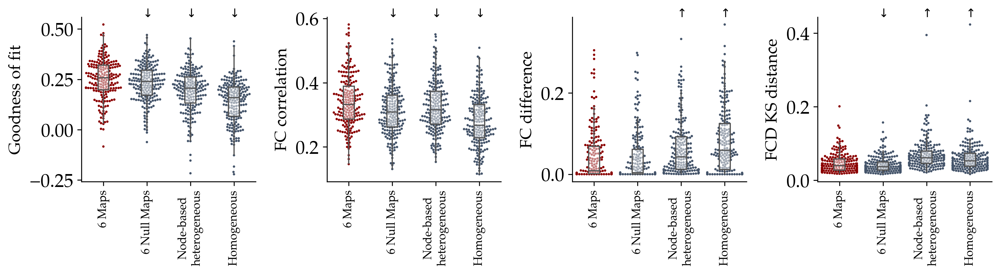

In [128]:
altmodels = ['main', '6maps_rot', 'node', 'homo']
altmodel_labels = ['6 Maps', '6 Null Maps', 'Node-based\nheterogeneous', 'Homogeneous']
data_model_combined = []
for alt in altmodels:
    all_data[alt]['Model'] = alt
    data_model_combined.append(all_data[alt].loc[:, ['gof', 'fc_corr', 'fcd_ks', 'fc_diff', 'Model']])
data_model_combined = pd.concat(data_model_combined, axis=0)
gof_measures = ['gof','fc_corr', 'fc_diff', 'fcd_ks']
fig, axd = plt.subplot_mosaic(
    [gof_measures],
    gridspec_kw=dict(width_ratios=[1]*4, height_ratios=[1]), 
    figsize=(12, 3.5)
)

for i, col in enumerate(gof_measures):
    label = gof_labels[col]
    ax = axd[col]
    sns.swarmplot(
        data=data_model_combined,
        x='Model', y=col, order=altmodels,
        s=2, palette=['darkred']+[thcolor]*6,
        ax=ax
    )
    sns.boxplot(
        data=data_model_combined,
        x='Model', y=col, order=altmodels,
        showfliers=False,
        showcaps=False, width=0.25,
        boxprops={"facecolor": (1, 1, 1, 0.5)},
        ax=ax)
    plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
    ax.set_ylabel(label, fontsize=14)
    ax.set_xlabel('')
    ax.set_xticklabels(altmodel_labels, rotation=90, fontsize=10)
    sns.despine()
    # statistics
    for j, alt in enumerate(altmodels[1:]):
        t, p = scipy.stats.ttest_rel(
            data_model_combined.loc[data_model_combined['Model']==alt, col],
            data_model_combined.loc[data_model_combined['Model']=='main', col]
        )
        if p < 0.05:
            text_x = j+0.85
            text_y = ax.get_ylim()[1]
            if t < 0:
                text = r'$\downarrow$'
            else:
                text = r'$\uparrow$'
            # text = '*'
            ax.text(text_x, text_y, text, fontsize=10, multialignment='center')
        mean_diff = (
            data_model_combined.loc[data_model_combined['Model']==alt, col] -
            data_model_combined.loc[data_model_combined['Model']=='main', col]
        ).mean()
        sd_diff = (
            data_model_combined.loc[data_model_combined['Model']==alt, col] -
            data_model_combined.loc[data_model_combined['Model']=='main', col]
        ).std()
        print(f"{label}: {alt} - main: t = {round(t, 3)}, p = {round(p,3)}, mean_diff = {round(mean_diff, 3)}, sd_diff = {round(sd_diff, 3)}")
fig.tight_layout(pad=1.0)

## S11C. Comparison of optimizer convergence in map-based versus node-independent models

Load the CMAES history of each model (main versus node-indendent) and each subsample subject, and calculate the range of GOF in the last generation as a measure of convergence:

In [135]:
params = {
    "G": "0.5-4",
    "wee": "0.05-0.75",
    "wei": "0.05-0.75",
    "wie": "0",
}
het_params = "wee-wei"

last_range = pd.DataFrame(columns=['maps', 'node'], dtype=float)
for sub in tqdm(subsample):
    # map-based default
    cmaes_folder = os.path.join(
        OUTPUT_DIR["pnc"],
        "sim",
        sub,
        "ctx_parc-schaefer-100_mean001_thresh-1",
        "6maps_schaefer-100_zscore",
        "cmaes_multimaps_gpu",
    )
    hist_maps, _, _ = load_cmaes_hist(
        cmaes_folder, params, het_params, SeedMW=1
    )
    hist_maps["iteration"] = hist_maps["iteration"].astype("int")
    hist_maps['gof'] += 1 # an extra -1 was added to gof during CMAES in these runs; remove it
    last_gof = hist_maps.loc[hist_maps['iteration']==hist_maps['iteration'].max(), 'gof']
    last_range.loc[sub, 'maps'] = last_gof.max() - last_gof.min()
    # node-independent
    hist_node = pd.read_csv(
        os.path.join(
            OUTPUT_DIR["pnc"],
            "sim", sub, 'ctx_parc-schaefer-100_mean001', 
            'node', 'cmaes_run-0', 'history.csv'
        ), index_col=0
    )
    last_gen = hist_node['gen'].max()
    if hist_node.loc[hist_node['gen']==last_gen].shape[0] == 1:
        # when early stop happens last gen will run the optimal simulation
        # and has a single particle
        last_gen = last_gen-1
    last_gof = hist_node.loc[hist_node['gen']==last_gen, '+gof']
    last_range.loc[sub, 'node'] = last_gof.max() - last_gof.min()

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 200/200 [03:38<00:00,  1.09s/it]


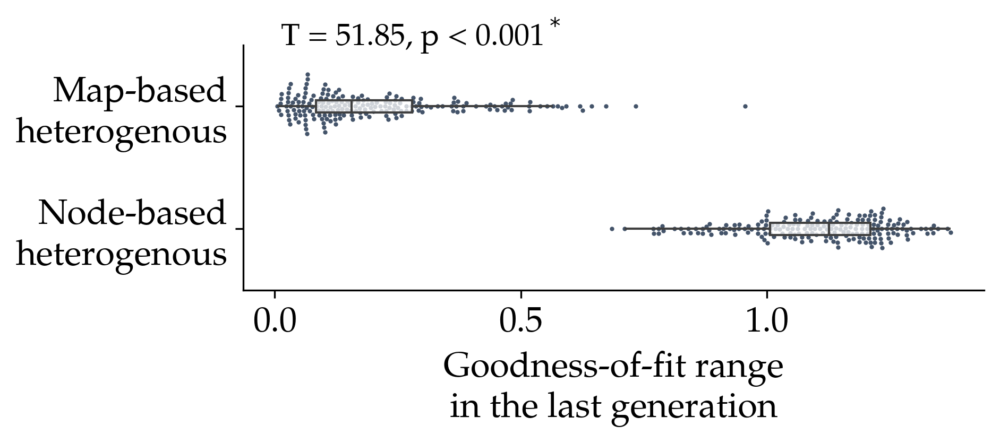

In [136]:
fig, ax = plt.subplots(figsize=(6, 2))
plot_data = last_range.unstack().reset_index()
sns.swarmplot(
    data=plot_data,
    y='level_0', x=0,
    s=2, color=thcolor,
    ax=ax
)
sns.boxplot(
    data=plot_data,
    y='level_0', x=0,
    showfliers=False,
    showcaps=False, width=0.1,
    boxprops={"facecolor": (1, 1, 1, 0.75)},
    ax=ax)
plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
ax.set_xlabel('Goodness-of-fit range\nin the last generation')
ax.set_yticklabels(['Map-based\nheterogenous', 'Node-based\nheterogenous'])
ax.set_ylabel('')
sns.despine()
# add statistics
t, p = scipy.stats.ttest_rel(
    last_range['node'], 
    last_range['maps'])
if add_text:
    if p > 0.001:
        text = f'T = {t:.2f}, p = {p:.3f}'
    else:
        text = f'T = {t:.2f}, p < 0.001'
    if p < 0.05:
        text+=r'$^*$'
    text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
    text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
    ax.text(text_x, text_y, 
            text,
            color='black',
            size=14,
            multialignment='left')

Plot GOF history of the last subject as an example:

(-1.4486158500000001, 0.41093084999999996)

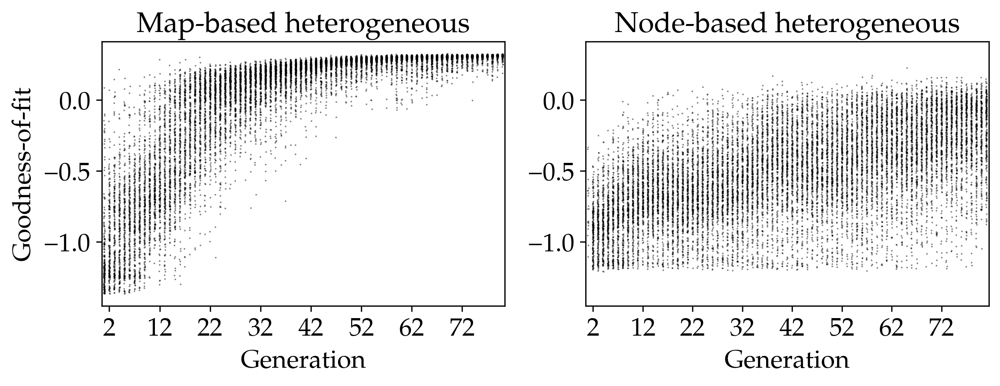

In [137]:
fig, axes = plt.subplots(1, 2, figsize=(10, 3))
ax_maps, ax_node = axes
sns.stripplot(data=hist_maps, x="iteration", y="gof", s=1, alpha=0.5, color="black", ax=ax_maps)
ax_maps.set_xticks(np.arange(1, 81, 10))
ax_maps.set_ylabel("Goodness-of-fit")
ax_maps.set_xlabel("Generation")
ax_maps.set_title('Map-based heterogeneous', fontsize=18)

# node-independent
sns.stripplot(data=hist_node, x="gen", y="+gof", s=1, alpha=0.5, color="black", ax=ax_node)
ax_node.set_xticks(np.arange(1, 81, 10))
ax_node.set_ylabel("")
ax_node.set_xlabel("Generation")
ax_node.set_title('Node-based heterogeneous', fontsize=18)

# align ylim
ylim = (
    min(ax_maps.get_ylim()[0], ax_node.get_ylim()[0]),
    max(ax_maps.get_ylim()[1], ax_node.get_ylim()[1])
)
ax_maps.set_ylim(ylim)
ax_node.set_ylim(ylim)

## S11D. Effect of age on E-I ratio in map-free models

### (left) Homogeneous 

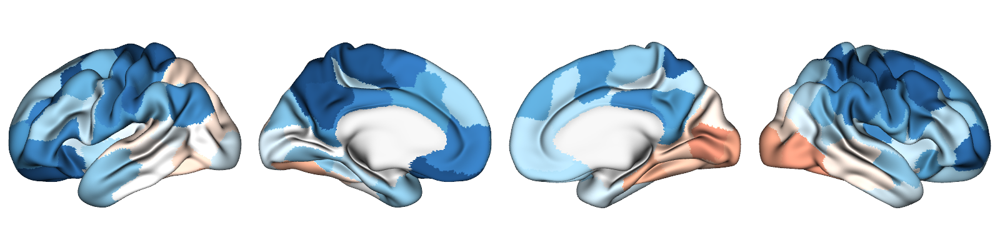

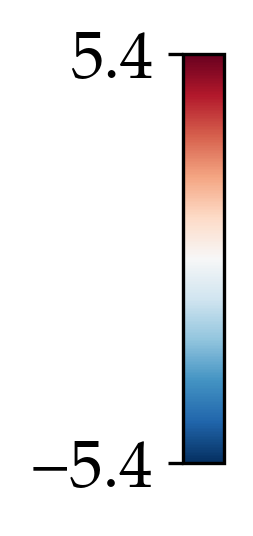

In [50]:
vmin = min(all_stats['homo']['t'].values.min(), -all_stats['homo']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['homo']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

Comparison with main age effect map (the plot is not reported in the figure):

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.3720623164771662 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.6697724160716105 ; p-vlaue: 0.0


<Axes: xlabel='E-I ratio age effect\n(Homogeneous)', ylabel='E-I ratio age effect\n(Map-based)'>

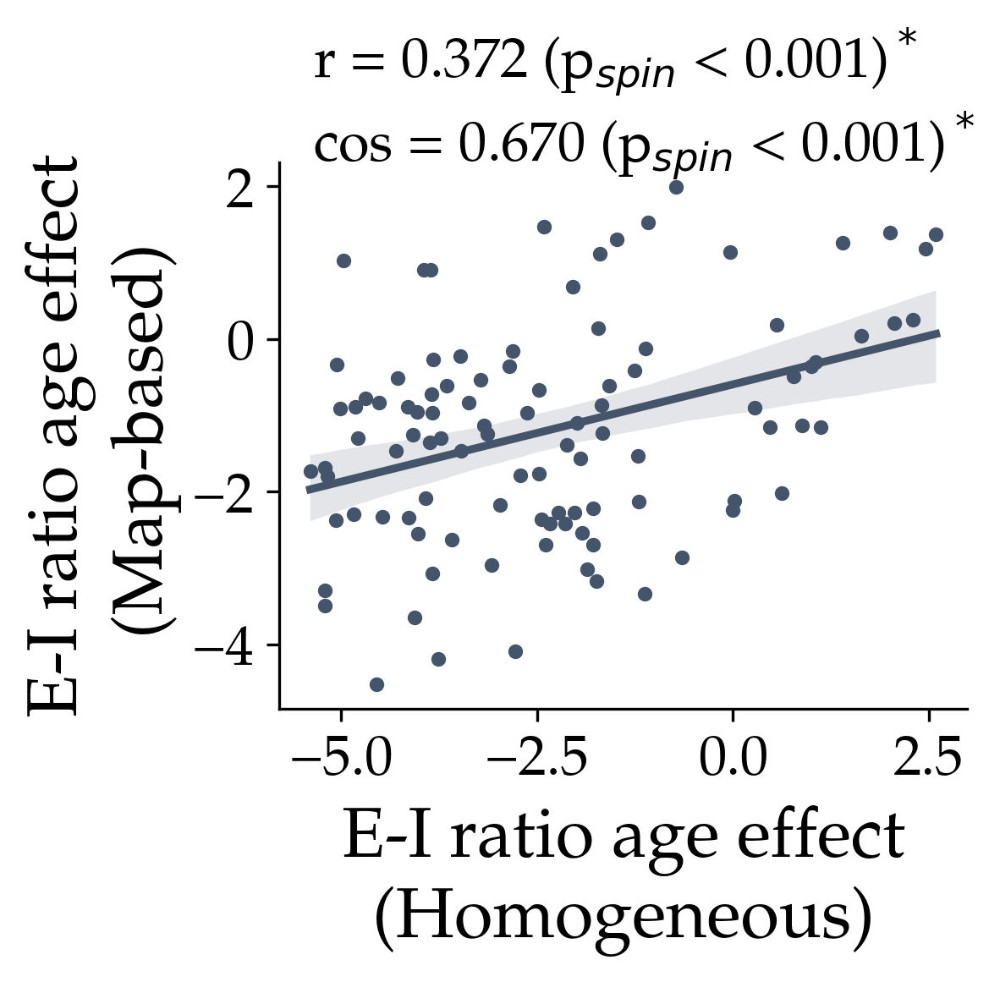

In [51]:
plot.reg_plot(
    all_stats['homo'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel=r'E-I ratio age effect''\n(Homogeneous)',
    ylabel=r'E-I ratio age effect''\n(Map-based)'
)

### (right) Node-independent

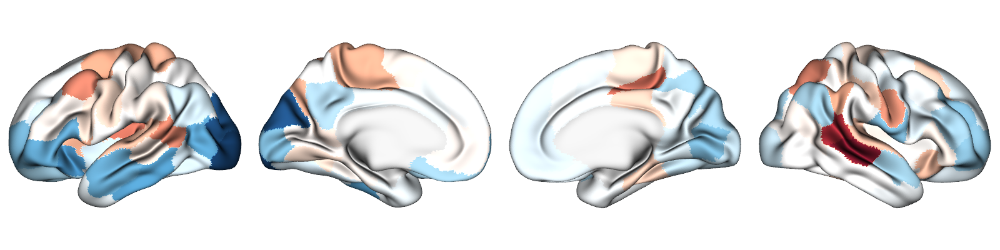

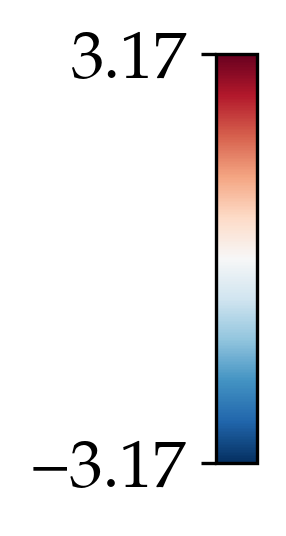

In [52]:
vmin = min(all_stats['node']['t'].values.min(), -all_stats['node']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['node']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

Comparison with main age effect map (the plot is not reported in the figure):

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.1017179782258076 ; p-vlaue: 0.338
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.14387925549429736 ; p-vlaue: 0.167


<Axes: xlabel='E-I ratio age effect\n(Node-independent)', ylabel='E-I ratio age effect\n(Map-based)'>

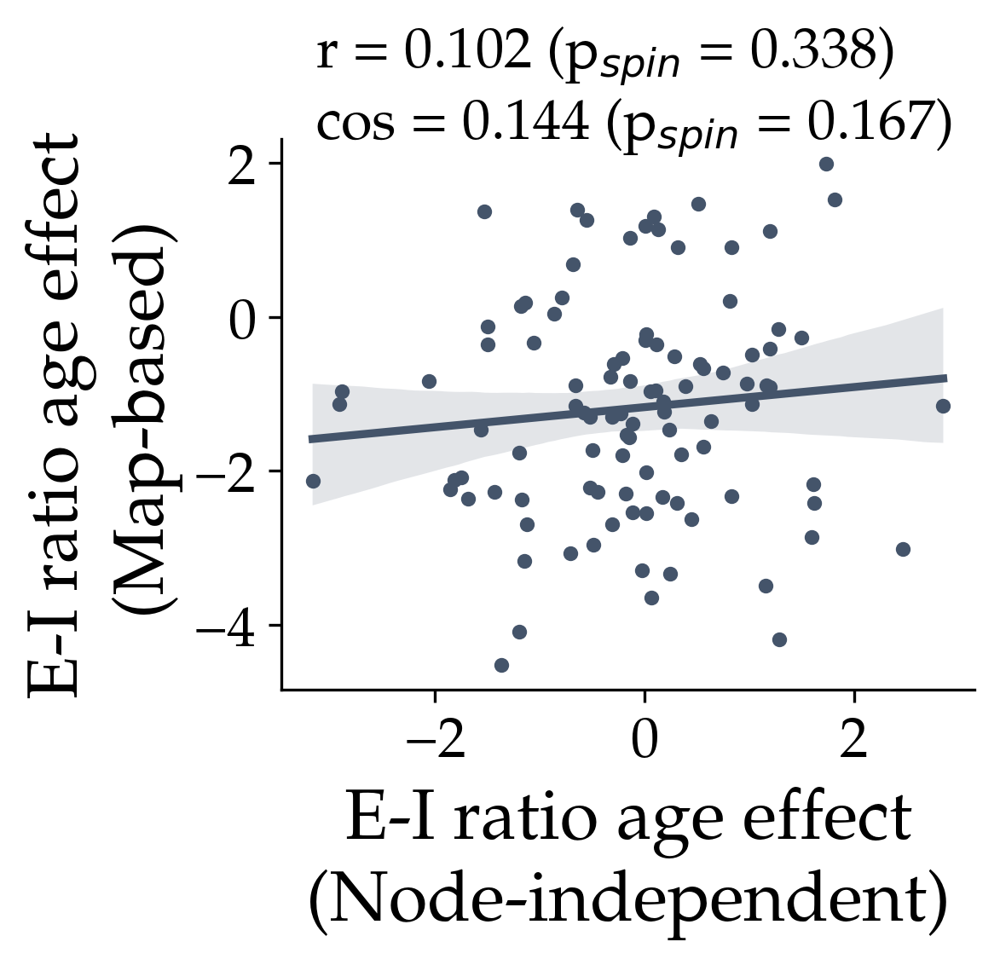

In [53]:
plot.reg_plot(
    all_stats['node'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel=r'E-I ratio age effect''\n(Node-independent)',
    ylabel=r'E-I ratio age effect''\n(Map-based)'
)

# Figure 5D and S12. Robustness of the findings to the inclusion of inter-hemispheric connections in the cost function

## 5D. Effect of age on E-I ratio with inter-hemispheric connections in cost (unthresholded)

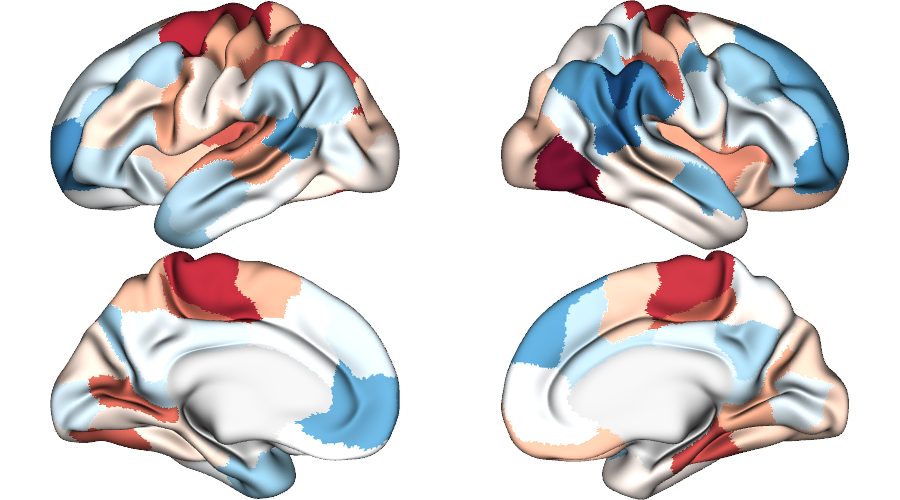

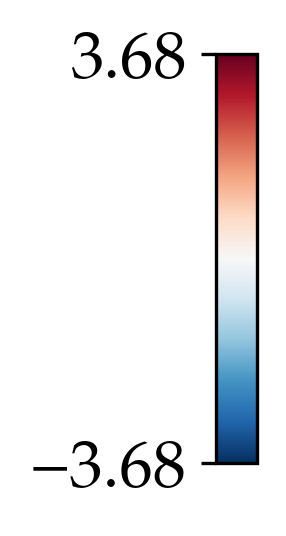

In [54]:
vmin = min(all_stats['inter']['t'].values.min(), -all_stats['inter']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(all_stats['inter']['t'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='grid',
)

## S12A. Effect of age on E-I ratio with inter-hemispheric connections in cost

### (left) FDR-significant effects

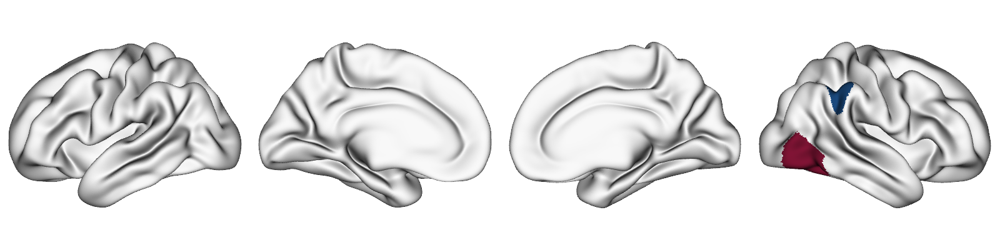

In [55]:
vmin = min(all_stats['inter']['t'].values.min(), -all_stats['inter']['t'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        all_stats['inter']['t'][all_stats['inter']['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=False,
    layout_style='row',
)

### (right) Comparison with main age effect map

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Correlation coefficient: 0.7339708695446305 ; p-vlaue: 0.0
permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Cosine similarity: 0.5318152224809611 ; p-vlaue: 0.0


Text(0, 0.5, 'E-I ratio age effect\n(Interhemispheric excluded)')

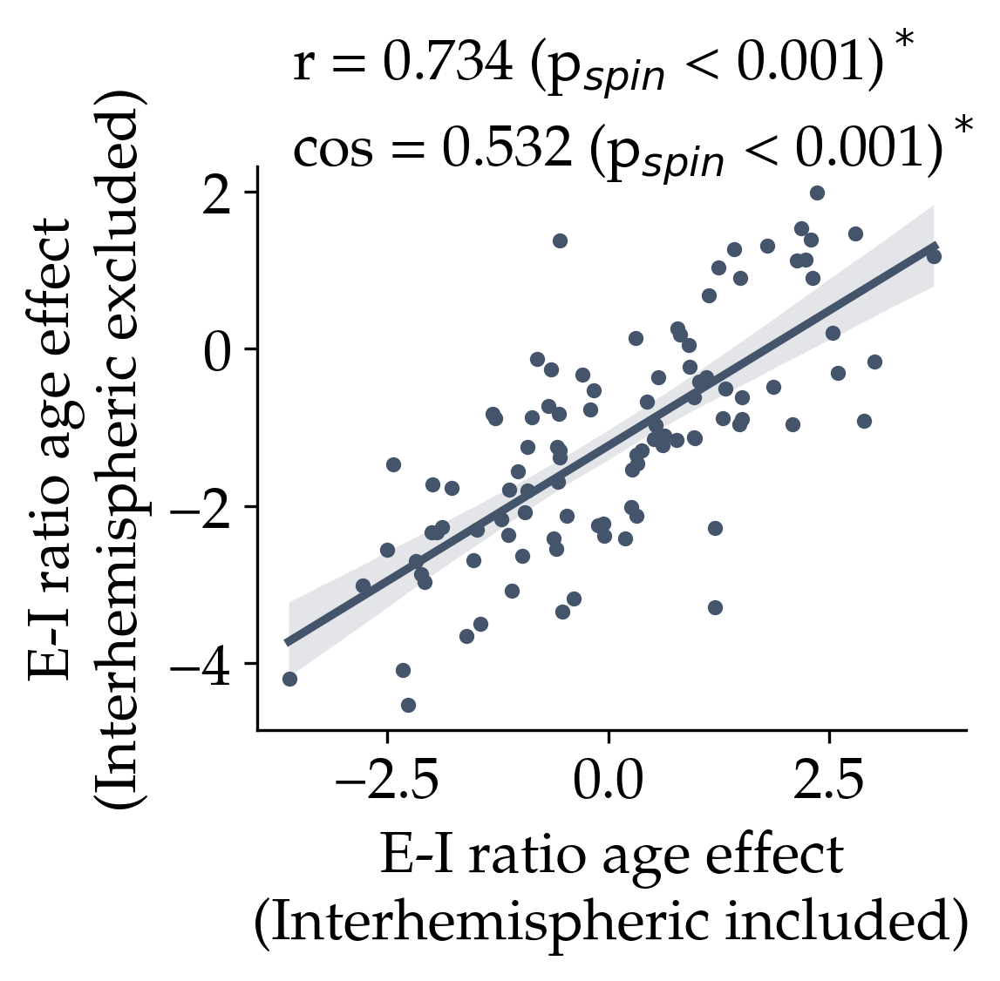

In [60]:
ax = plot.reg_plot(
    all_stats['inter'][['t']], all_stats['main'][['t']], 'schaefer-100',
    xlabel='E-I ratio age effect''\n(Interhemispheric included)',
    ylabel='E-I ratio age effect''\n(Interhemispheric excluded)'
)
ax.set_xlabel(ax.get_xlabel(), fontsize=16)
ax.set_ylabel(ax.get_ylabel(), fontsize=16)

## S12B. ICC

       younger    older      all
count  100.000  100.000  100.000
mean     0.440    0.490    0.484
std      0.154    0.164    0.128
min      0.069    0.077    0.071
25%      0.315    0.381    0.410
50%      0.477    0.513    0.497
75%      0.553    0.618    0.572
max      0.776    0.804    0.743
T =-2.8334984478459435, p = 0.005580164363852859


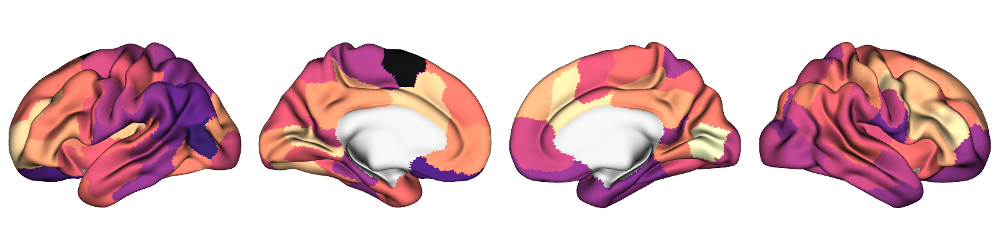

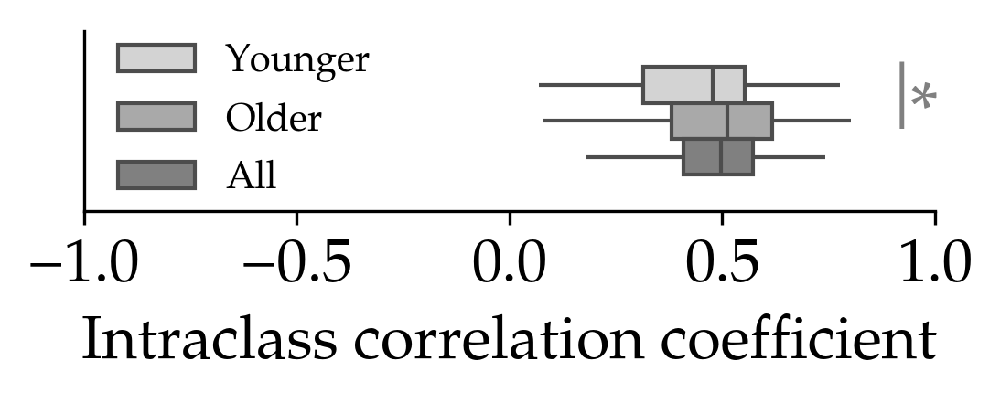

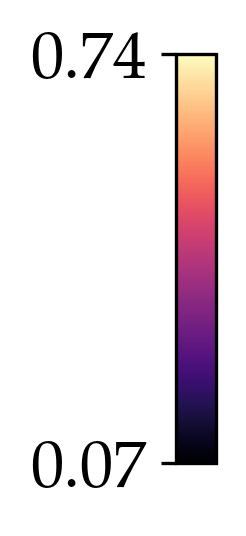

In [61]:
print(all_ICCs_by_age['inter'].describe().round(3))
plot.plot_icc_by_age(all_ICCs_by_age['inter'], 'schaefer-100')

## S12C. Comparison of GOF

Goodness of fit	-21.85	0.0	-0.145	0.094
FC correlation	-28.167	0.0	-0.11	0.055
SC-FC coupling	-75.831	0.0	-0.076	0.014
FC difference	7.059	0.0	0.033	0.067
FCD KS distance	0.995	0.321	0.002	0.023


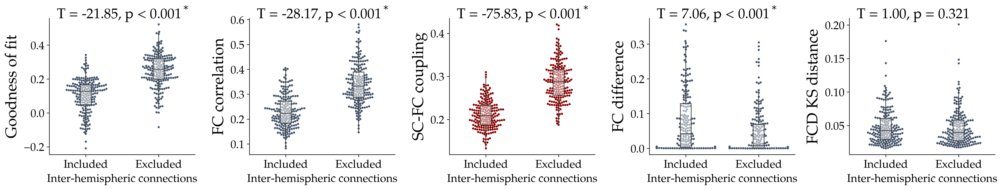

In [62]:
all_data['inter']['Inter-hemispheric connections'] = 'Included'
all_data['main']['Inter-hemispheric connections'] = 'Excluded'
data_combined = pd.concat([all_data['inter'], all_data['main']], axis=0)
gof_measures = ['gof','fc_corr', 'sc_fc', 'fc_diff', 'fcd_ks']
fig, axd = plt.subplot_mosaic(
    [gof_measures],
    gridspec_kw=dict(width_ratios=[1]*5, height_ratios=[1]), 
    figsize=(20, 4)
)

for i, col in enumerate(gof_measures):
    label = gof_labels[col]
    ax = axd[col]
    if col == 'sc_fc':
        color = 'darkred'
    else:
        color= '#44546A'
    sns.swarmplot(
        data=data_combined,
        x='Inter-hemispheric connections', y=col,
        s=3, color=color,
        ax=ax
    )
    sns.boxplot(
        data=data_combined,
        x='Inter-hemispheric connections', y=col,
        showfliers=False,
        showcaps=False, width=0.15,
        boxprops={"facecolor": (1, 1, 1, 0.5)},
        ax=ax)
    plt.setp(ax.collections, zorder=0, label="") # puts swarm in the back
    ax.set_ylabel(label, fontsize=22)
    sns.despine()
    # add statistics
    alt = all_data['inter'].loc[:, col]
    main = all_data['main'].loc[:, col]
    t, p = scipy.stats.ttest_rel(alt, main)
    if add_text:
        if p > 0.001:
            text = f'T = {t:.2f}, p = {p:.3f}'
        else:
            text = f'T = {t:.2f}, p < 0.001'
        if p < 0.05:
            text+=r'$^*$'
        text_x = ax.get_xlim()[0]+(ax.get_xlim()[1]-ax.get_xlim()[0])*0.05
        text_y = ax.get_ylim()[0]+(ax.get_ylim()[1]-ax.get_ylim()[0])*1
        ax.text(text_x, text_y, 
                text,
                color='black',
                size=20,
                multialignment='left')
    mean_diff = (alt - main).mean()
    sd_diff = (alt - main).std()
    print(label, round(t, 3), round(p,3), round(mean_diff,3), round(sd_diff,3), sep="\t")
fig.tight_layout(pad=1.0)

# Figure 5F and S13. Meta-analysis of effects of age on E-I ratio across alternative models

## 5F. Pooled age effects

In [63]:
# for schaefer-200 reparcellate it into schaefer-100 so the maps can be combined
all_stats['sch200reparc'] = transform.parcellate_surf(transform.deparcellate_surf(all_stats['sch200'], 'schaefer-200'), 'schaefer-100', concat=True)
all_stats['sch200reparc'].columns = all_stats['main'].columns
all_stats['sch200reparc']['N'] = all_stats['sch200reparc']['N'].round().astype('int')

# convert Rs and Ns of analyses reported in Fig 5 to dataframes
# which will be used in the meta-analyses
meta_alts = ['main', 'sc_temp', 'sch200reparc', '2maps', 'nmda_gabaa', '4maps', 'inter']
all_Rs = pd.DataFrame({k: all_stats[k]['r'] for k in meta_alts})
all_Ns = pd.DataFrame({k: all_stats[k]['N'].astype('int') for k in meta_alts})

# in each node run a REML meta-aanlysis using PyMARE
# with the partial correlation of age with <I_Ei> as the effect size
meta_results = {}
for parc in parcels:
    dset = pymare.effectsize.OneSampleEffectSizeConverter(
        r = all_Rs.loc[parc, :], 
        n = all_Ns.loc[parc, :]
    ).to_dataset(measure='R')
    est = pymare.estimators.VarianceBasedLikelihoodEstimator(method="REML").fit_dataset(dset)
    results = est.summary()
    meta_results[parc] = results.to_df().iloc[0, 1:]
    meta_het_stats = results.get_heterogeneity_stats()
    meta_results[parc]['I^2'] = meta_het_stats['I^2'][0]
    meta_results[parc]['p(Q)'] = meta_het_stats['p(Q)'][0]
meta_results = pd.DataFrame(meta_results).T.astype(float)
# FDR correction
_, meta_results['p_fdr'] = statsmodels.stats.multitest.fdrcorrection(meta_results['p-value'])

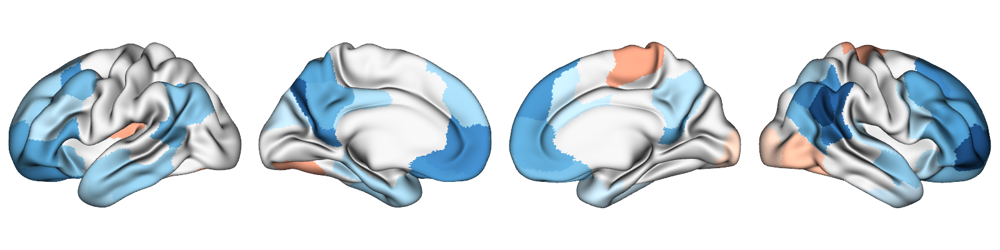

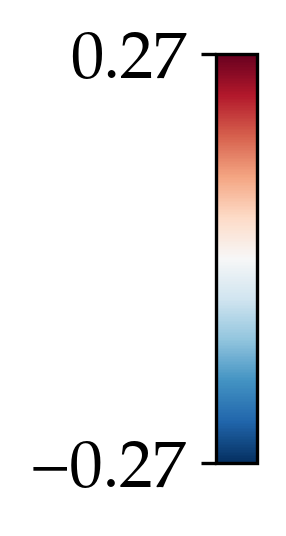

In [64]:
vmin = min(meta_results['estimate'].values.min(), -meta_results['estimate'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        meta_results['estimate'][meta_results['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

## S13A. $I^2$ heterogeneity index across alternative models

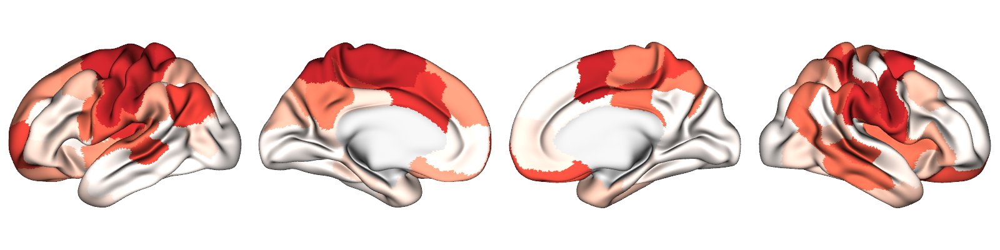

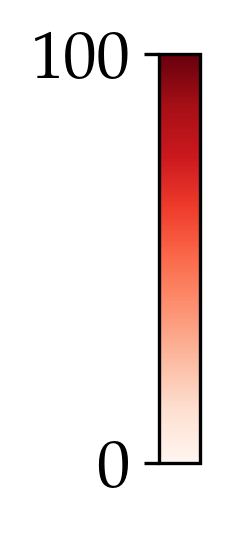

In [65]:
plot.plot_surface(
    transform.deparcellate_surf(meta_results['I^2'], 'schaefer-100', concat=True, space='fsaverage'), 
    'fsaverage', mesh_kind='semi-inflated',
    cmap='Reds', cbar=True, vrange=(0, 100),
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

## S13B. Significant pooled age effects excluding parcels with significant heterogeneity across alternative models

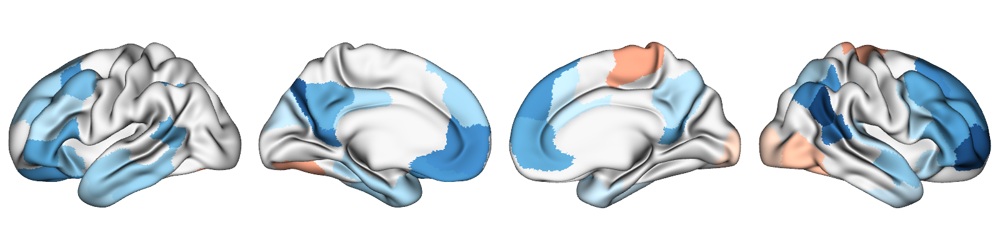

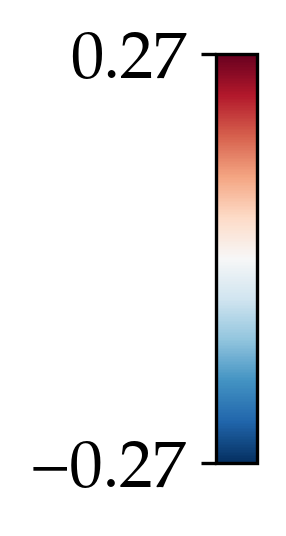

In [66]:
sig_nonhet_estimates = meta_results['estimate'][(meta_results['p_fdr']<0.05) & (meta_results['p(Q)']>=0.05)]
vmin = min(sig_nonhet_estimates.values.min(), -sig_nonhet_estimates.values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        sig_nonhet_estimates, 'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)

## S13C. Pooled effects additionally including map-free models

In [67]:
# convert Rs and Ns of analyses reported in Fig 5 to dataframes
# which will be used in the meta-analyses
meta_alts_all = ['main', 'sc_temp', 'sch200reparc', '2maps', 'nmda_gabaa', '4maps', 'inter', 'homo', 'node']
all_Rs = pd.DataFrame({k: all_stats[k]['r'] for k in meta_alts})
all_Ns = pd.DataFrame({k: all_stats[k]['N'].astype('int') for k in meta_alts})

# in each node run a REML meta-aanlysis using PyMARE
# with the partial correlation of age with <I_Ei> as the effect size
meta_results_all = {}
for parc in parcels:
    dset = pymare.effectsize.OneSampleEffectSizeConverter(
        r = all_Rs.loc[parc, :], 
        n = all_Ns.loc[parc, :]
    ).to_dataset(measure='R')
    est = pymare.estimators.VarianceBasedLikelihoodEstimator(method="REML").fit_dataset(dset)
    results = est.summary()
    meta_results_all[parc] = results.to_df().iloc[0, 1:]
    meta_het_stats = results.get_heterogeneity_stats()
    meta_results_all[parc]['I^2'] = meta_het_stats['I^2'][0]
    meta_results_all[parc]['p(Q)'] = meta_het_stats['p(Q)'][0]
meta_results_all = pd.DataFrame(meta_results_all).T.astype(float)
# FDR correction
_, meta_results_all['p_fdr'] = statsmodels.stats.multitest.fdrcorrection(meta_results_all['p-value'])

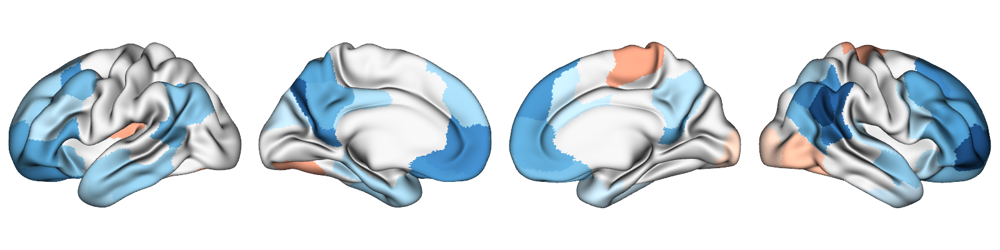

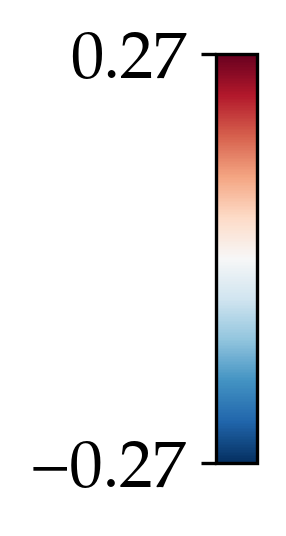

In [68]:
vmin = min(meta_results_all['estimate'].values.min(), -meta_results_all['estimate'].values.max()).round(2)
vmax = -vmin
plot.plot_surface(
    transform.deparcellate_surf(
        meta_results_all['estimate'][meta_results_all['p_fdr']<0.05], 
        'schaefer-100', concat=True, space='fsaverage'
    ), 
    'fsaverage', mesh_kind='semi-inflated',
    vrange=(vmin, vmax), cmap='RdBu_r', cbar=True,
    cbar_kwargs=dict(figsize=(2,2)),
    layout_style='row',
)